# Online DA: HadCRUT obs assimilated 
Katie Brennan  
Februrary 16, 2022  

In [1]:
import sys
import numpy as np
import xarray as xr
import datetime
import scipy.stats as stats

import matplotlib.pyplot as plt
import matplotlib.path as mpath
import cartopy.crs as ccrs

import pickle 

In [2]:
from matplotlib.ticker import (MultipleLocator, FormatStrFormatter,AutoMinorLocator)

In [3]:
sys.path.append("../../")
import Online_DA_utils as oda

In [4]:
sys.path.append("/home/disk/p/mkb22/Documents/si_analysis_kb/LIMs/SI_LIMs/")

import LIM_utils_kb as limkb
import LIM_stats_kb as statskb
# import LIM_plot_kb as plotkb
import LIM_building as limbuild

In [5]:
import importlib
importlib.reload(oda)
importlib.reload(limkb)

<module 'LIM_utils_kb' from '/home/disk/p/mkb22/Documents/si_analysis_kb/LIMs/SI_LIMs/LIM_utils_kb.py'>

In [6]:
def load_annual_walsh(version=None):
    """
    Loads annualized total Arctic extent and area from Walsh et al version 1 or 2. 
    
    INPUTS: 
    version: integer value indicating the value of Walsh data to load (takes values: 1,2,None)
    
    OUTPUTS: 
    walsh_sia: total arctic sea ice area (km^2)
    walsh_sie: total arctic sea ice extent (km^2)
    walsh_time: years of walsh data (years)
    """
    walsh_directory = '/home/disk/chaos/mkb22/Documents/SeaIceData/Walsh2016/walsh_comparison/'
    
    if version is None: 
        vera = 2
        vere = 2
    elif version == 3: 
        vera = 2
        vere = 3
    else: 
        vera = version
        vere = version

    walsh_sie_file_an = 'Walsh_annual_sie_km2_v'+str(vere)+'.npz'
    walsh_sia_file_an = 'Walsh_annual_sia_km2_v'+str(vera)+'.npz'

    walsh_sie_data_an = np.load(walsh_directory + walsh_sie_file_an)
    walsh_sia_data_an = np.load(walsh_directory + walsh_sia_file_an)
    
    walsh_time = walsh_sie_data_an['years']
    
    if version ==2: 
        walsh_sia = walsh_sia_data_an['walsh_nh_annual_area_total']/1e6
        walsh_sie = walsh_sie_data_an['walsh_nh_annual_extent_total']/1e6
    elif version ==3:     
        walsh_sia = walsh_sia_data_an['walsh_nh_annual_area_total']/1e6
        walsh_sie = walsh_sie_data_an['walsh_nh_annual_extent_total_amn_first']/1e6
    else: 
        walsh_sia = walsh_sia_data_an['walsh_nh_annual_area_total']
        walsh_sie = walsh_sie_data_an['walsh_nh_annual_extent_total']
    
#     if ver == 1: 
#         walsh_time = np.arange(1850,2014,1)
#     else: 
#         walsh_time = np.arange(1850,2018,1)
    
    return walsh_sia, walsh_sie, walsh_time

In [7]:
def find_anomalies(TIME, VAR, ANOM_START, ANOM_END, mean=False):
    """Finds anomalies between (and including) ANOM_START and ANOM_END. 
       inputs: 
       TIME = array of years (time) 
       VAR = variable to take anomalies of (time)
       ANOM_START = year anomaly period starts
       ANOM_END = year anomaly period ends (included) 
    """
   
    gt = np.where(TIME>=ANOM_START)
    lt = np.where(TIME<=ANOM_END)
    
    VAR_mean = np.nanmean(VAR[gt[0].min():lt[0].max()],axis=0)
    VAR_anom = VAR - VAR_mean
    
    if mean is True: 
        return VAR_anom, VAR_mean
    else: 
        return VAR_anom

In [8]:
def load_monthly_walsh(version=None):
    walsh_directory = '/home/disk/chaos/mkb22/Documents/SeaIceData/Walsh2016/walsh_comparison/'
    filename_sia_mo = 'Walsh_monthly_sia_km2.npz'
    filename_sie_mo = 'Walsh_monthly_sie_km2.npz'

    walsh_sia_data_an = np.load(walsh_directory + filename_sia_mo)
    walsh_sie_data_an = np.load(walsh_directory + filename_sie_mo)

    walsh_sie_mo = walsh_sie_data_an['walsh_nh_monthly_extent_total']
    walsh_sia_mo = walsh_sia_data_an['walsh_nh_monthly_area_total']
    walsh_years = walsh_sia_data_an['years']
    
    return walsh_years, walsh_sia_mo, walsh_sie_mo

In [9]:
plt.rcParams['figure.dpi']=300

In [10]:
limvars = ['tas','tos','psl','zg','sit','sic']

In [11]:
niters = 20
it_list = np.arange(1,niters+1,1)

## Load experiment: 

In [12]:
#limname = 'multimod_CESM1_MPI_GFDL_HadGEM3_CanESM_Amon'
#limname = 'multimod_MPI_GFDL_HadGEM3_CanESM_Amon'
limname = 'cesm_lme_Amon'

LIM = oda.load_L(limname)
LIMd = LIM['LIMd']
LIMd.keys()

Loading: /home/disk/kalman2/mkb22/SI_LIMs/sensitivity_testing/master/LIMcast_cesm_lme_Amon_ntrain_850_1650_cesm_lme_Amon_validy_1651_1850_tas50L0.1_psl50L0.1_zg50L0.1_tos50L0.1_sit50L40_sic50L40_20211202_sqrtWt.pkl


dict_keys(['vec', 'veci', 'val', 'lam_L', 'C_0', 'C_1', 'Gt', 'lam_L_adj', 'npos_eigenvalues', 'E3', 'W_all', 'standard_factor', 'E3_all', 'E_sic', 'var_dict', 'P_train', 'exp_setup', 'frac_neg_eigenvals'])

In [13]:
nyears = 170
#nyears = 155

# Generate times: 
t_total = nyears*12
years = int(1851+np.floor((t_total-1)/12))
time = np.array([datetime.datetime(y, m, 15) for y in np.arange(1851,1851+nyears,1) for m in np.arange(1,13,1)])

In [14]:
output_dir = '/home/disk/kalman2/mkb22/Online_DA/experiments/hadcrut/nobs50/'
data_all = {}
Xa_dcomp_all = {}
#Xa_dcomp = np.zeros((niters,LIMd['E3_all'].shape[0]+LIMd['E_sic'].shape[0],data['Xa'].shape[0]))
nmodes = LIMd['E3_all'].shape[1]

for i,it in enumerate(it_list):
    print('working on iteration '+str(it))
#     filename = ('ODA_prior_cesm_lme_Amon_LIM_cesm_lme_Amon_obs_hadCRUT_all_rand50_t_0_2040'+
#                 '_nomj_trainR_it'+str(it)+'.pkl')
    filename = ('ODA_prior_cesm_lme_Amon_LIM_cesm_lme_Amon_obs_hadCRUT_all_rand100_t_0_2040'+
                '_nomj_trainR1_it'+str(it)+'.pkl')
#     filename = ('ODA_prior_cesm_lme_Amon_LIM_cesm_lme_Amon_obs_cmip6_mpi_hist_regridlme_Amon_'+
#                 'rand50_t_0_1860_nomj_trainRe_it'+str(it)+'_test.pkl')

    data_all[it] = pickle.load(open(output_dir+filename,"rb"))
    
    if i is 0: 
        Xa_dcomp = np.zeros((niters,LIMd['E3_all'].shape[0]+LIMd['E_sic'].shape[0],data_all[it]['Xa'].shape[0]))

    Xa_dcomp[i,:,:] = limkb.decompress_eof_separate_sic(data_all[it]['Xa'].T,nmodes,LIMd['exp_setup']['nmodes_sic'],
                                                         LIMd['E3_all'],LIMd['E_sic'],LIMd['exp_setup']['limvars'],
                                                         LIMd['var_dict'],LIMd['W_all'],Weights=LIMd['exp_setup']['Weight'],
                                                         sic_separate=LIMd['exp_setup']['sic_separate'])

working on iteration 1
working on iteration 2
working on iteration 3
working on iteration 4
working on iteration 5
working on iteration 6
working on iteration 7
working on iteration 8
working on iteration 9
working on iteration 10
working on iteration 11
working on iteration 12
working on iteration 13
working on iteration 14
working on iteration 15
working on iteration 16
working on iteration 17
working on iteration 18
working on iteration 19
working on iteration 20


In [15]:
for var in limvars: 
    Xa_dcomp_var = np.zeros((niters, LIMd['var_dict'][var]['var_ndof'],data_all[1]['Xa'].shape[0]))
    for i,it in enumerate(it_list):
        Xa_dcomp_var[i,:,:] = Xa_dcomp[i,LIMd['var_dict'][var]['var_inds'],:]

    Xa_dcomp_all[var] = Xa_dcomp_var

(-10, 10)

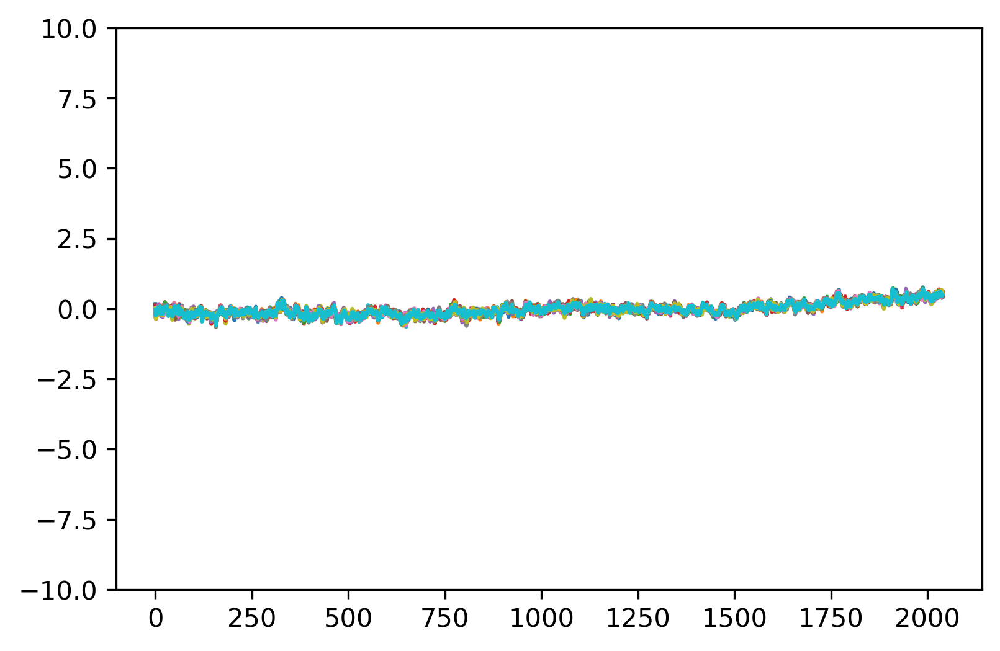

In [16]:
for it in range(20):
    plt.plot(Xa_dcomp_all['tas'][it,0,:])

plt.ylim(-10,10)

In [17]:
obs_mean = np.zeros((t_total))

for t in range(t_total):
    obs_mean[t] = np.nanmean(data_all[1]['obs_assimilated'][t]['obs'])

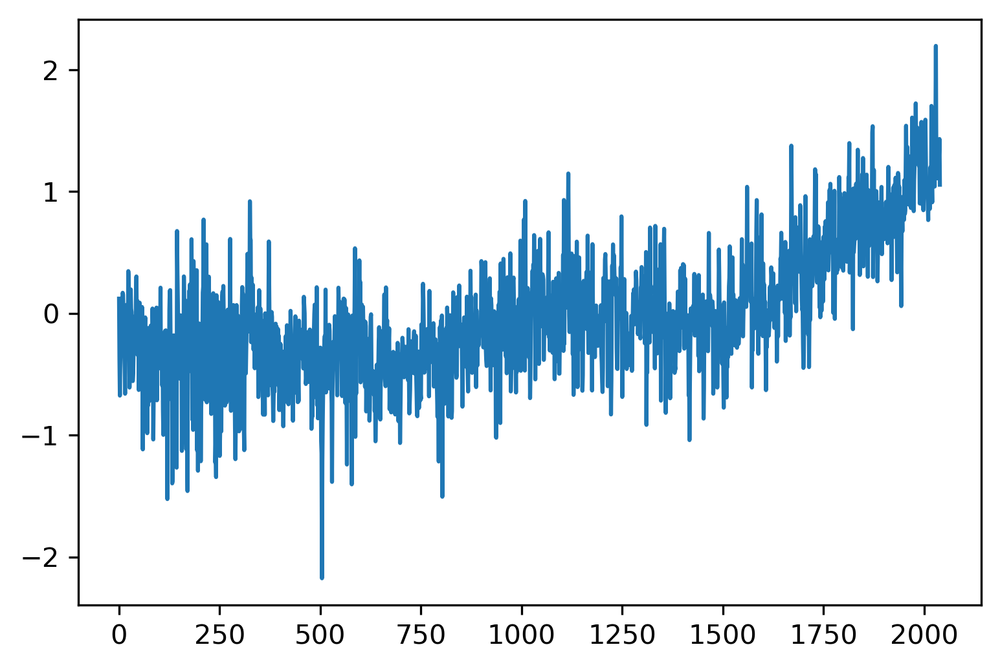

In [18]:
plt.plot(obs_mean)

In [19]:
diag_K_den = np.zeros((t_total,50))
for t in range(t_total):
    diag_K_den[t,:] = np.diagonal(data_all[1]['K_den'][t,:,:])

plt.plot(np.var(data_all[1]['diff'],axis=1), label='y-Hxb')
plt.plot(np.var(diag_K_den,axis=0), label='prior + obs uncertainty')
plt.plot(np.var(data_all[1]['R_intime'],axis=0), label='Var(R)')
plt.plot(np.var(data_all[1]['HPbHT_intime'],axis=0), label='Var(HPbHT)')
plt.legend()
plt.ylim(0,30)
plt.xlabel('observation locations')

ValueError: could not broadcast input array from shape (100) into shape (50)

In [20]:
cov_d = np.matmul(data_all[1]['diff'],data_all[1]['diff'].T)/(data_all[1]['diff'].shape[1]-1)
Kden_diag = np.diagonal(np.nanmean(data_all[1]['K_den'],axis=0))

Text(0.5, 0, 'observation locations')

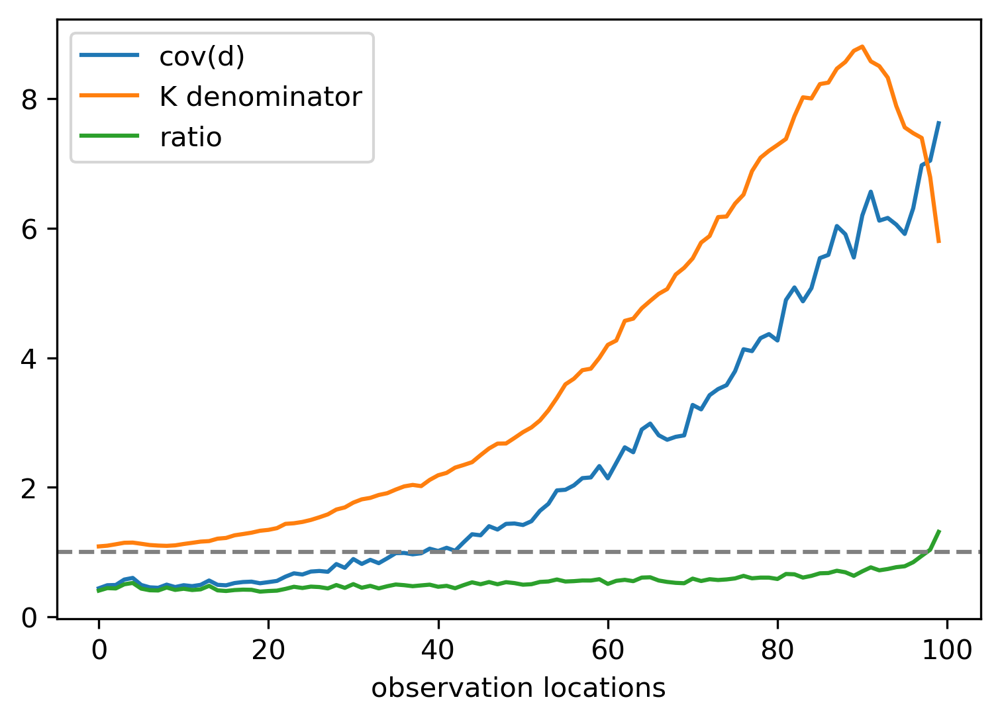

In [21]:
plt.plot(np.diagonal(cov_d),label='cov(d)')
plt.plot(Kden_diag, label='K denominator')
plt.plot(np.diagonal(cov_d)/Kden_diag, label='ratio')
plt.axhline(1,linestyle='--',color='gray')
plt.legend()
plt.xlabel('observation locations')

In [22]:
Kden_diag = np.diagonal(np.nanmean(data_all[1]['K_den'],axis=0))

In [23]:
Pb_trace_all = np.zeros((niters,data_all[1]['Pb_trace'].shape[0]))
ratio_mean_all = np.zeros((niters,data_all[1]['ratio_mean_100'].shape[0]))
ratio_median_all = np.zeros((niters,data_all[1]['ratio_median_100'].shape[0]))

for i,it in enumerate(it_list): 
    Pb_trace_all[i,:] = data_all[it]['Pb_trace']
    ratio_mean_all[i,:] = data_all[it]['ratio_mean_100']
    ratio_median_all[i,:] = data_all[it]['ratio_median_100']

In [24]:
ratio_mean_97_5 = np.percentile(ratio_mean_all,97.5,axis=0)
ratio_mean_2_5 = np.percentile(ratio_mean_all,2.5,axis=0)

ratio_median_97_5 = np.percentile(ratio_median_all,97.5,axis=0)
ratio_median_2_5 = np.percentile(ratio_median_all,2.5,axis=0)

Text(0, 0.5, '$cov(d,d)/[HP_bH^{T}+R]$')

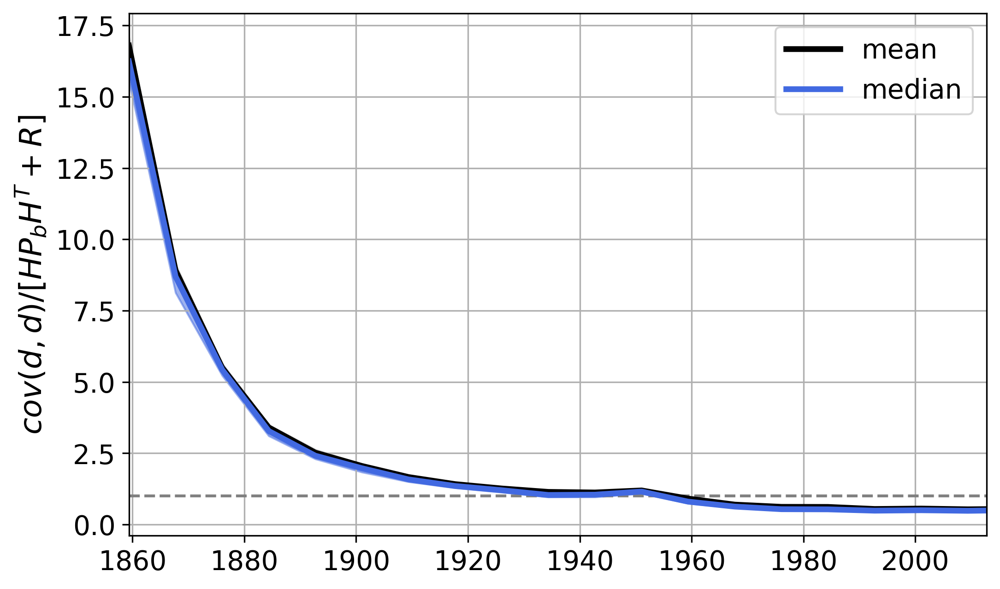

In [25]:
fig, ax = plt.subplots(figsize=(8, 5))
# plt.plot(time[0:10],np.zeros(10),color='gray',linestyle='--',label='control-R',linewidth=3)
# plt.plot(time[0:10],np.zeros(10),color='gray',linestyle='-',label='regression-R',linewidth=3)
plt.axhline(1,color='gray',linestyle='--')

plt.plot(time[100::100],np.mean(ratio_mean_all,axis=0), color='k', linewidth=3, label='mean')
plt.plot(time[100::100],np.mean(ratio_median_all,axis=0),color='royalblue', linewidth=3, label='median')

plt.fill_between(time[100::100],ratio_mean_2_5,ratio_mean_97_5, color='k', alpha=0.2)
plt.fill_between(time[100::100],ratio_median_2_5,ratio_median_97_5,color='royalblue', alpha=0.5)

plt.grid()
plt.xlim(time[100],time[-100])
plt.legend(fontsize=14)
plt.xticks(fontsize=14)
plt.yticks(fontsize=14)
plt.ylabel('$cov(d,d)/[HP_bH^{T}+R]$', fontsize=16)

#plt.ylim(0,10)

In [223]:
np.mean(np.mean(ratio_mean_all,axis=0)), np.median(np.median(ratio_mean_all,axis=0))

(2.600977723851215, 1.1685264435894516)

In [224]:
np.mean(np.mean(ratio_mean_all,axis=0)), np.median(np.median(ratio_mean_all,axis=0))

(2.600977723851215, 1.1685264435894516)

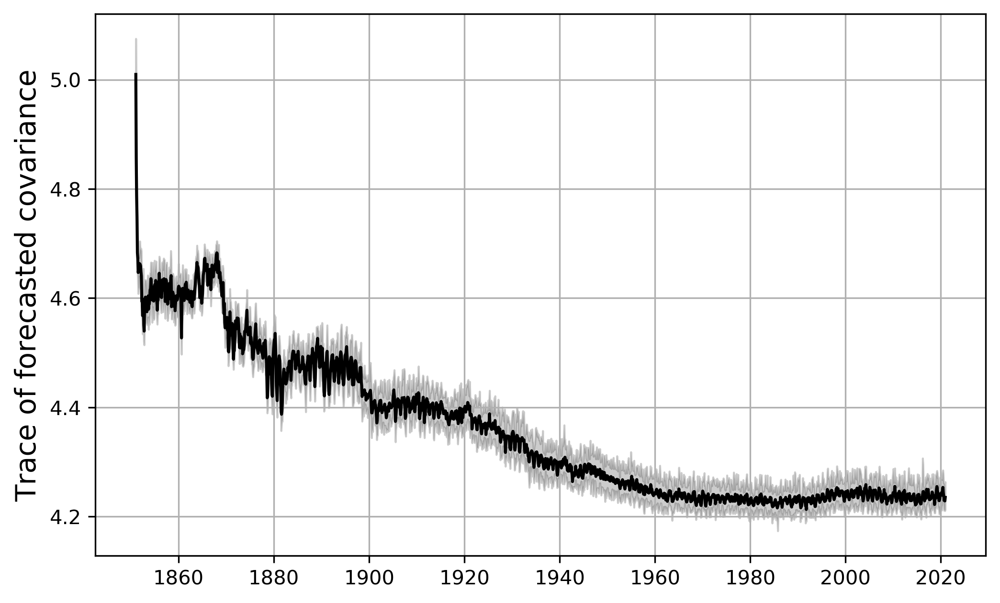

In [225]:
fig, ax = plt.subplots(figsize=(8, 5))

plt.plot(time, np.mean(Pb_trace_all,axis=0), color='k')
plt.fill_between(time, np.percentile(Pb_trace_all,2.5,axis=0),
                 np.percentile(Pb_trace_all,97.5,axis=0),color='k',alpha=0.2)

plt.ylabel('Trace of forecasted covariance', fontsize=14)
plt.title('', fontsize=16)
plt.grid()
#plt.xlim(time[0],time[-1])
#plt.ylim(4.8, 5.65)

### Load temperature products: 

In [26]:
GIS_tas, GIS_lat, GIS_lon, GIS_time = oda.load_GISTEMP()
GIS_nhmean = oda.global_mean_noarea(GIS_tas[:,45:,:], GIS_lat[45:])

In [27]:
BE_tas, BE_lat, BE_lon, BE_time = oda.load_BerkeleyEarth()
BE_nhmean = oda.global_mean_noarea(BE_tas[:,90:,:], BE_lat[90:])

In [28]:
HadCRUT_tas, HadCRUT_lat, HadCRUT_lon, HadCRUT_time = oda.load_HadCRUT5()
Had_nhmean = oda.global_mean_noarea(HadCRUT_tas[:,18:,:], HadCRUT_lat[18:])

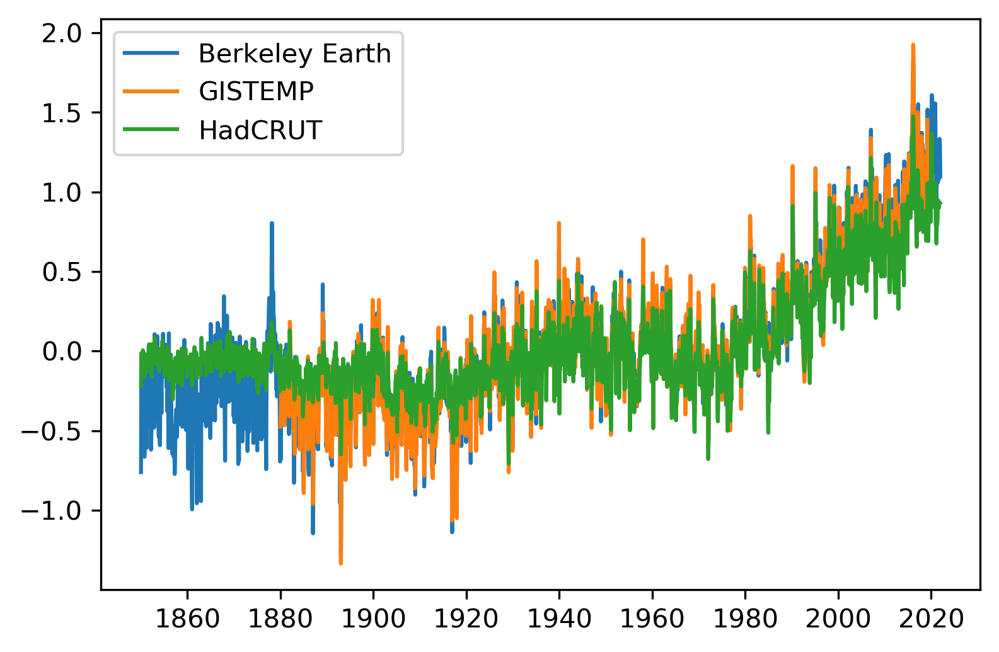

In [29]:
plt.plot(BE_time,BE_nhmean, label='Berkeley Earth')
plt.plot(GIS_time,GIS_nhmean, label='GISTEMP')
plt.plot(HadCRUT_time,Had_nhmean, label='HadCRUT')
plt.legend()

## Full field: pan-Arctic skill

In [30]:
valid_dsource = 'cesm_lme_Amon'
fdic_valid = limkb.build_training_dic(valid_dsource)

In [31]:
full_names, areawt_name, month_names = limbuild.load_full_names(valid_dsource)

areacell_dict_all = {}
areacell = {}
for var in limvars:
    areacell_dict = {}
    areacell[var], areacell_dict_all[var] = limkb.load_data(areawt_name[var], areacell_dict, fdic_valid, 
                                                            remove_climo=False, detrend=False, verbose=False, 
                                                            lat_cutoff=LIMd['exp_setup']['lat_cutoff'][var])

Loading from cuments/SeaIceData/LME/LIMs/areacella_CESM_LME_global_001.nc
latitude cutoff detected: 0.1
Loading from cuments/SeaIceData/LME/LIMs/areacella_CESM_LME_global_001.nc
latitude cutoff detected: 0.1
Loading from cuments/SeaIceData/LME/LIMs/areacella_CESM_LME_global_001.nc
latitude cutoff detected: 0.1
Loading from cuments/SeaIceData/LME/LIMs/areacella_CESM_LME_global_001.nc
latitude cutoff detected: 0.1
Loading from cuments/SeaIceData/LME/LIMs/areacella_CESM_LME_global_001.nc
latitude cutoff detected: 40
Loading from cuments/SeaIceData/LME/LIMs/areacella_CESM_LME_global_001.nc
latitude cutoff detected: 40


In [32]:
tot_var_forecast_all = {}
var_dict = LIMd['var_dict']

for var in limvars: 
    tot_var_forecast = np.zeros((niters,t_total))
    
    print('Working on '+var)
    units = areacell_dict_all[var][areawt_name[var]]['units']

    if 'km' in units:
        acell = areacell[var]
    elif 'centi' in units: 
        print('changing cellarea units from '+
              str(areacell_dict_all[var][areawt_name[var]]['units'])+' to km^2')
        acell = areacell[var]*(1e-10)
        units = 'km^2'
    else: 
        print('changing cellarea units from '+
              str(areacell_dict_all[var][areawt_name[var]]['units'])+' to km^2')
        acell = areacell[var]*(1e-6)
        units = 'km^2'
    
    for i,it in enumerate(it_list):
        if var == 'sic':
            nlon = int(var_dict[var]['var_ndof']/var_dict[var]['lat'].shape[0])
            tot_var_forecast[i,:] = oda.calc_tot_si_checks(Xa_dcomp_all[var][i,:,:],acell,units,
                                                           var_dict[var]['lat'],nlon,lat_cutoff=0.0)
        else: 
            tot_var_forecast[i,:] = oda.global_mean(Xa_dcomp_all[var][i,:,:],acell)
            
    tot_var_forecast_all[var] = tot_var_forecast

Working on tas
changing cellarea units from m^2 to km^2
Working on tos
changing cellarea units from m^2 to km^2
Working on psl
changing cellarea units from m^2 to km^2
Working on zg
changing cellarea units from m^2 to km^2
Working on sit
changing cellarea units from m^2 to km^2
Working on sic
changing cellarea units from m^2 to km^2


In [33]:
full_names = {'tas':'Surface air temperature ($^\circ$C)', 
              'tos':'Sea surface temperature ($^\circ$C)',
              'psl':'Sea level pressure (Pa)',
              'zg': '500 hPa Geopotential Height (m)',
              'sit': 'Sea ice thickness (m)',
              'sic': 'Sea ice area (10$^6$ km$^2$)'}

var_units = {'tas':'$^\circ$C', 
              'tos':'$^\circ$C',
              'psl':'Sea level pressure',
              'zg': 'm',
              'sit': 'm',
              'sic': '10$^6$ km$^2$'}

Text(0, 0.5, 'Northern hemisphere mean')

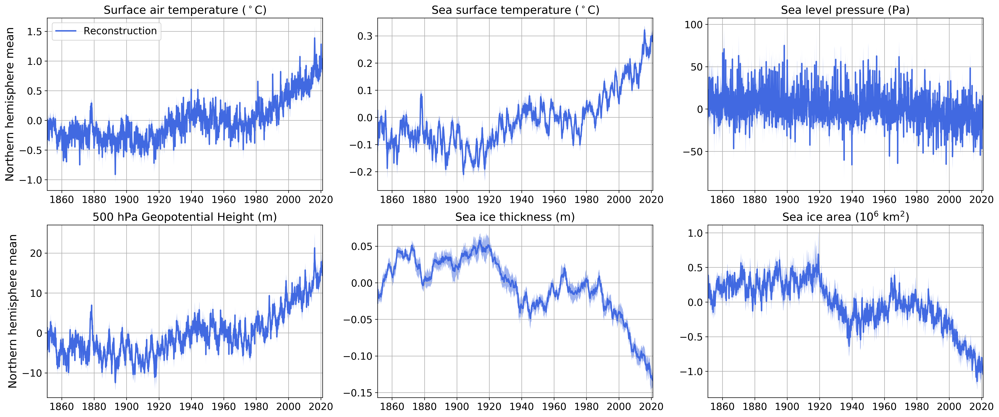

In [34]:
fig,axs = plt.subplots(2,3, figsize=(24,10))
ax = axs.flatten()

#ax[0].plot(GIS_time,GIS_nhmean, color='k',label='GISTEMP')

for i,var in enumerate(limvars):
    if 'sic' in var: 
        forecast = tot_var_forecast_all[var]*1e-6
    else: 
        forecast = tot_var_forecast_all[var]
    
    ax[i].plot(time, np.mean(forecast,axis=0), label='Reconstruction', color='royalblue',linewidth=2)
    ax[i].fill_between(time, np.percentile(forecast,2.5,axis=0), np.percentile(forecast,97.5,axis=0),
                       alpha=0.5, color='royalblue', linewidth=0.0)


    ax[i].set_title(full_names[var], fontsize=16)
    ax[i].grid()
    ax[i].set_xlim(time[0],time[-1])
#     ax[i].set_ylabel(var_units[var], fontsize=16)
    ax[i].tick_params(axis='both', which='major', labelsize=14)
#     if 'psl' in var:
#         ax[i].set_ylim(-50,50)

ax[0].legend(fontsize=14)
ax[0].set_ylabel('Northern hemisphere mean', fontsize=16)
ax[3].set_ylabel('Northern hemisphere mean', fontsize=16)

# savename ='figures/allvar_recon_LIMmultimod_Had50obs_inf2_20it_obs_sample_spread.png'
# plt.savefig(savename)

In [38]:
# fixedfolder = '/home/disk/kalman2/mkb22/Online_DA/experiments/hadcrut/nobs50/'
# fixedfile = 'ODA_prior_CESMLME_Hadcrut_fixedcov_20it_R0_4_nobs100_nhmeans.pkl'

# pickle.dump(tot_var_forecast_all, open(fixedfolder+fixedfile, "wb" ) )

In [39]:
fixedfolder = '/home/disk/kalman2/mkb22/Online_DA/experiments/hadcrut/nobs50/'
fixedfile = 'ODA_prior_CESMLME_Hadcrut_fixedcov_20it_nhmeans.pkl'
fixedfileR10 ='ODA_prior_CESMLME_Hadcrut_fixedcov_Rdiv10_20it_nhmeans.pkl'
freefileR10 = ('ODA_prior_CESMLME_Hadcrut_Rdiv10_20it_nhmeans.pkl')

tot_var_forecast_all_fixedcov = pickle.load(open(fixedfolder+fixedfile,"rb"))
tot_var_forecast_all_fixedcovR10 = pickle.load(open(fixedfolder+fixedfileR10,"rb"))
tot_var_forecast_all_R10 = pickle.load(open(fixedfolder+freefileR10,"rb"))

Text(0, 0.5, 'Northern hemisphere mean')

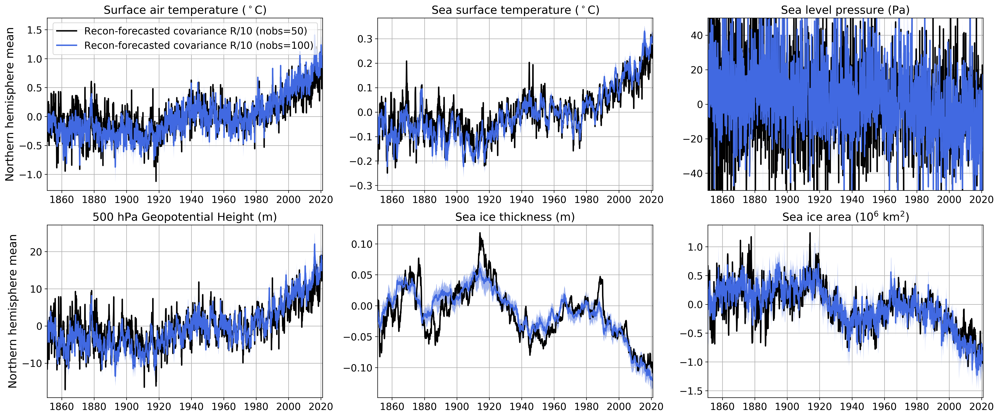

In [65]:
fig,axs = plt.subplots(2,3, figsize=(24,10))
ax = axs.flatten()

#ax[0].plot(GIS_time,GIS_nhmean, color='k',label='GISTEMP')

for i,var in enumerate(limvars):
    if 'sic' in var: 
        forecast = tot_var_forecast_all[var]*1e-6
        fixedcov = tot_var_forecast_all_fixedcov[var]*1e-6
        fixedcovR10 = tot_var_forecast_all_fixedcovR10[var]*1e-6
        freecovR10 = tot_var_forecast_all_R10[var]*1e-6
    else: 
        forecast = tot_var_forecast_all[var]
        fixedcov = tot_var_forecast_all_fixedcov[var]
        fixedcovR10 = tot_var_forecast_all_fixedcovR10[var]
        freecovR10 = tot_var_forecast_all_R10[var]
    
#    ax[i].plot(time, np.mean(fixedcov,axis=0), label='Recon-fixed covariance', color='k',linewidth=2)
#    ax[i].plot(time, np.mean(fixedcovR10,axis=0), label='Recon-fixed covariance R/10', color='m',linewidth=2)
#    ax[i].plot(time, np.mean(fixedcov,axis=0), label='Recon-fixed covariance', color='k',linewidth=2)
    ax[i].plot(time, np.mean(freecovR10,axis=0), label='Recon-forecasted covariance R/10 (nobs=50)', color='k',linewidth=2)
     
    ax[i].plot(time, np.mean(forecast,axis=0), label='Recon-forecasted covariance R/10 (nobs=100)', color='royalblue',linewidth=2)
    ax[i].fill_between(time, np.percentile(forecast,2.5,axis=0), np.percentile(forecast,97.5,axis=0),
                       alpha=0.5, color='royalblue', linewidth=0.0)

    ax[i].set_title(full_names[var], fontsize=16)
    ax[i].grid()
    ax[i].set_xlim(time[0],time[-1])
    ax[i].tick_params(axis='both', which='major', labelsize=14)
    if 'psl' in var:
        ax[i].set_ylim(-50,50)

ax[0].legend(fontsize=14)
ax[0].set_ylabel('Northern hemisphere mean', fontsize=16)
ax[3].set_ylabel('Northern hemisphere mean', fontsize=16)

# savename ='figures/allvar_recon_LIMmultimod_Had50obs_inf2_20it_obs_sample_spread.png'
# plt.savefig(savename)

# TAS comparisons: 

In [235]:
import pandas as pd
GIS_time_dt = pd.to_datetime(GIS_time)
HadCRUT_time_dt = pd.to_datetime(HadCRUT_time)

In [236]:
BE_ind = np.where((BE_time<=time[-1]) & (BE_time>=time[0]))[0]

corr_recon_BE, ce_recon_BE = oda.calc_corr_ce(BE_nhmean[BE_ind],np.mean(tot_var_forecast_all['tas'],axis=0))
corr_recon_BE**2, ce_recon_BE

(0.9488260736992842, 0.8932416165744318)

In [237]:
GIS_time_dt,time[-1]

(DatetimeIndex(['1880-01-15', '1880-02-15', '1880-03-15', '1880-04-15',
                '1880-05-15', '1880-06-15', '1880-07-15', '1880-08-15',
                '1880-09-15', '1880-10-15',
                ...
                '2018-06-15', '2018-07-15', '2018-08-15', '2018-09-15',
                '2018-10-15', '2018-11-15', '2018-12-15', '2019-01-15',
                '2019-02-15', '2019-03-15'],
               dtype='datetime64[ns]', length=1671, freq=None),
 datetime.datetime(2020, 12, 15, 0, 0))

In [238]:
recon_ind = np.where((time>=GIS_time_dt[0])&(time<=GIS_time_dt[-1]))[0]

corr_recon_GIS, ce_recon_GIS = oda.calc_corr_ce(GIS_nhmean,
                                                np.mean(tot_var_forecast_all['tas'],axis=0)[recon_ind])
corr_recon_GIS**2, ce_recon_GIS

(0.9535039444842149, 0.9087454167663808)

In [239]:
Had_ind = np.where((HadCRUT_time_dt<=time[-1]) & (HadCRUT_time_dt>=time[0]))[0]

corr_recon_Had, ce_recon_Had = oda.calc_corr_ce(Had_nhmean[Had_ind],
                                                np.mean(tot_var_forecast_all['tas'],axis=0)[:-1])
corr_recon_Had**2, ce_recon_Had

(0.886852426251639, 0.8461432715456724)

In [240]:
start = GIS_time[0]
end = GIS_time[1091]

anom_ind_GIS = (GIS_time>=start)&(GIS_time<=end)
anom_ind_BE = (BE_time>=pd.to_datetime(start))&(BE_time<=pd.to_datetime(end))
anom_ind_Had = (HadCRUT_time>=pd.to_datetime(start))&(HadCRUT_time<=pd.to_datetime(end))
anom_ind_recon = (time>=pd.to_datetime(start))&(time<=pd.to_datetime(end))

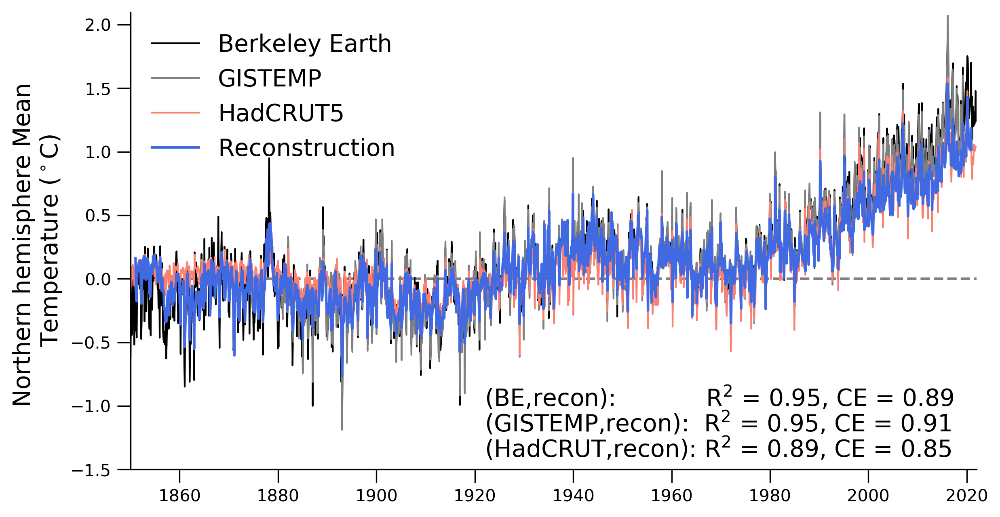

In [241]:
fig,ax = plt.subplots(1,1, figsize=(9,5))
plt.axhline(0,linestyle='--',color='gray')

ax.plot(BE_time,BE_nhmean-np.nanmean(BE_nhmean[anom_ind_BE]), color='k',label='Berkeley Earth', linewidth=1)
ax.plot(GIS_time,GIS_nhmean-np.nanmean(GIS_nhmean[anom_ind_GIS]), color='gray',label='GISTEMP', linewidth=1)
ax.plot(HadCRUT_time,Had_nhmean-np.nanmean(Had_nhmean[anom_ind_Had]), color='salmon',
        label='HadCRUT5',linewidth=1)

tas_recon_ensmn = np.mean(tot_var_forecast_all['tas'],axis=0)

ax.plot(time, tas_recon_ensmn - np.mean(tas_recon_ensmn[anom_ind_recon]), 
        label='Reconstruction', color='royalblue', linewidth=1.5)

#ax.grid()
plt.xlim(BE_time[0],BE_time[-1])
plt.ylim(-1.5,2.1)

ax.legend(fontsize=14,frameon=False, loc='upper left')
ax.set_ylabel('Northern hemisphere Mean \nTemperature ($^\circ$C)', fontsize=14)

plt.text(BE_time[-1200],-1.0,'(BE,recon):            R$^2$ = '+str(np.round(corr_recon_BE**2,2))+
         ', CE = '+str(np.round(ce_recon_BE,2)), fontsize=14)
plt.text(BE_time[-1200],-1.2,'(GISTEMP,recon):  R$^2$ = '+str(np.round(corr_recon_GIS**2,2))+
         ', CE = '+str(np.round(ce_recon_GIS,2)), fontsize=14)
plt.text(BE_time[-1200],-1.4,'(HadCRUT,recon): R$^2$ = '+str(np.round(corr_recon_Had**2,2))+
         ', CE = '+str(np.round(ce_recon_Had,2)), fontsize=14)

ax.tick_params(which='major', length=8)
ax.tick_params(which='minor', length=4)
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)

savename ='figures/tas_recon_LIMmultimod_Had50obs_20it_comparison_gis_be_had.png'
#plt.savefig(savename)

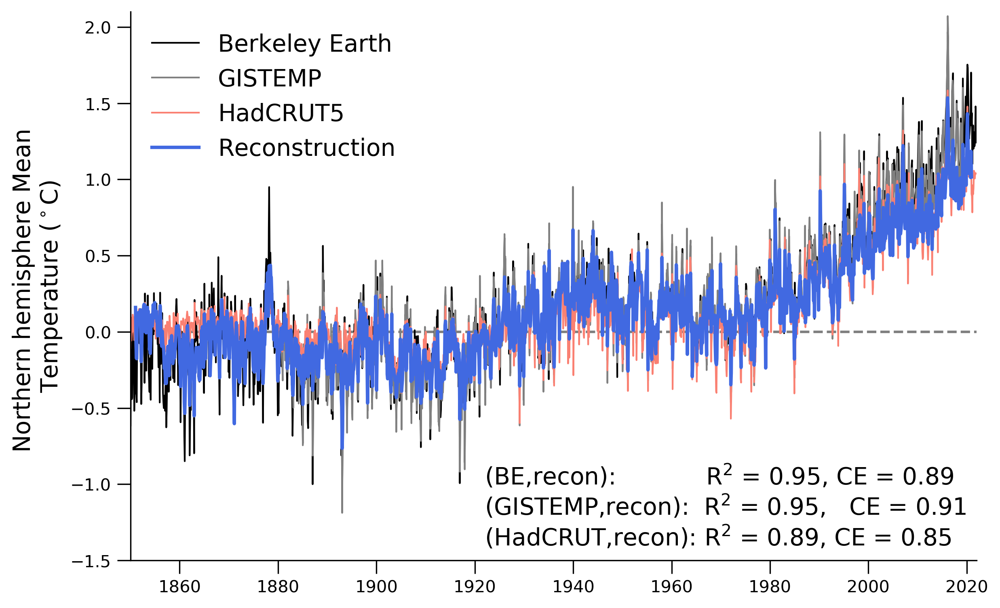

In [242]:
fig,ax = plt.subplots(1,1, figsize=(9,6))
plt.axhline(0,linestyle='--',color='gray')

ax.plot(BE_time,BE_nhmean-np.nanmean(BE_nhmean[anom_ind_BE]), color='k',label='Berkeley Earth', linewidth=1)
ax.plot(GIS_time,GIS_nhmean-np.nanmean(GIS_nhmean[anom_ind_GIS]), color='gray',label='GISTEMP', linewidth=1)
ax.plot(HadCRUT_time,Had_nhmean-np.nanmean(Had_nhmean[anom_ind_Had]), color='salmon',
        label='HadCRUT5',linewidth=1)

tas_recon_ensmn = np.mean(tot_var_forecast_all['tas'],axis=0)

ax.plot(time, tas_recon_ensmn - np.mean(tas_recon_ensmn[anom_ind_recon]), 
        label='Reconstruction', color='royalblue', linewidth=2)

#ax.grid()
plt.xlim(BE_time[0],BE_time[-1])
plt.ylim(-1.5,2.1)

ax.legend(fontsize=14,frameon=False, loc='upper left')
ax.set_ylabel('Northern hemisphere Mean \nTemperature ($^\circ$C)', fontsize=14)

plt.text(BE_time[-1200],-1.0,'(BE,recon):            R$^2$ = '+str(np.round(corr_recon_BE**2,2))+
         ', CE = '+str(np.round(ce_recon_BE,2)), fontsize=14)
plt.text(BE_time[-1200],-1.2,'(GISTEMP,recon):  R$^2$ = '+str(np.round(corr_recon_GIS**2,2))+
         ',   CE = '+str(np.round(ce_recon_GIS,2)), fontsize=14)
plt.text(BE_time[-1200],-1.4,'(HadCRUT,recon): R$^2$ = '+str(np.round(corr_recon_Had**2,2))+
         ', CE = '+str(np.round(ce_recon_Had,2)), fontsize=14)

ax.tick_params(which='major', length=8)
ax.tick_params(which='minor', length=4)
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)

savename ='figures/tas_recon_LIMmultimod_Had50obs_20it_comparison_gis_be_had.png'
#plt.savefig(savename)

# SST Comparison: 

In [243]:
import pandas as pd

In [244]:
GFDLECDA_sst, GFDLECDA_lat, GFDLECDA_lon, GFDLECDA_time = oda.load_GFDLECDA()
HadleyEN4_sst, HadleyEN4_lat, HadleyEN4_lon, HadleyEN4_time = oda.load_HadleyEN4()
ORA20C_sst, ORA20C_lat, ORA20C_lon, ORA20C_time = oda.load_ORA20C()

HadleyEN4_time = HadleyEN4_time[40*12:]

In [245]:
GFDLECDA_nhmean = oda.global_mean_noarea(GFDLECDA_sst[:,96:,:], GFDLECDA_lat[96:])
HadleyEN4_nhmean = oda.global_mean_noarea(HadleyEN4_sst[40*12:,83:,:], HadleyEN4_lat[83:])
ORA20C_nhmean = oda.global_mean_noarea(ORA20C_sst[:,90:,:], ORA20C_lat[90:])

In [246]:
GFDLECDA_nhmean_mo = np.reshape(GFDLECDA_nhmean,(50,12))
HadleyEN4_nhmean_mo = np.reshape(HadleyEN4_nhmean,(71,12))
ORA20C_nhmean_mo = np.reshape(ORA20C_nhmean,(110,12))

In [247]:
GFDLECDA_nhmean_moanom = (GFDLECDA_nhmean_mo - np.nanmean(GFDLECDA_nhmean_mo,axis=0)[np.newaxis,:]).flatten()
HadleyEN4_nhmean_moanom = (HadleyEN4_nhmean_mo - np.nanmean(HadleyEN4_nhmean_mo,axis=0)[np.newaxis,:]).flatten()
ORA20C_nhmean_moanom = (ORA20C_nhmean_mo - np.nanmean(ORA20C_nhmean_mo,axis=0)[np.newaxis,:]).flatten()

tos_recon_ensmn = np.mean(tot_var_forecast_all['tos'],axis=0)

In [248]:
start = GFDLECDA_time[0]
end = ORA20C_time[-109]

anom_ind_GFDL = (GFDLECDA_time>=pd.to_datetime(start))&(GFDLECDA_time<=pd.to_datetime(end))
anom_ind_ORA = (ORA20C_time>=pd.to_datetime(start))&(ORA20C_time<=pd.to_datetime(end))
anom_ind_Hadley = (HadleyEN4_time>=pd.to_datetime(start))&(HadleyEN4_time<=pd.to_datetime(end))
anom_ind_recon = (time>=pd.to_datetime(start))&(time<=pd.to_datetime(end))

In [249]:
GFDLECDA_nhmean_anom = GFDLECDA_nhmean_moanom - np.nanmean(GFDLECDA_nhmean_moanom[anom_ind_GFDL])
HadleyEN4_nhmean_anom = HadleyEN4_nhmean_moanom - np.nanmean(HadleyEN4_nhmean_moanom[anom_ind_Hadley])
ORA20C_nhmean_anom = ORA20C_nhmean_moanom - np.nanmean(ORA20C_nhmean_moanom[anom_ind_ORA ])
recon_nhmean_anom = tos_recon_ensmn - np.nanmean(tos_recon_ensmn[anom_ind_recon])

In [250]:
GFDLECDA_inds = (time<=GFDLECDA_time[-1])&(time>=GFDLECDA_time[0])
HadleyEN4_inds = (time<=pd.to_datetime(HadleyEN4_time[-1]))&(time>=pd.to_datetime(HadleyEN4_time[0]))
ORA20C_inds = (time<=pd.to_datetime(ORA20C_time[-1]))&(time>=pd.to_datetime(ORA20C_time[0]))

In [251]:
corr_recon_GFDLECDA, ce_recon_GFDLECDA = oda.calc_corr_ce(GFDLECDA_nhmean_anom,tos_recon_ensmn[GFDLECDA_inds])
corr_recon_HadleyEN4, ce_recon_HadleyEN4 = oda.calc_corr_ce(HadleyEN4_nhmean_anom[1:],tos_recon_ensmn[HadleyEN4_inds])
corr_recon_ORA20C, ce_recon_ORA20C = oda.calc_corr_ce(ORA20C_nhmean_anom[1:] ,tos_recon_ensmn[ORA20C_inds])

In [252]:
corr_recon_GFDLECDA, ce_recon_GFDLECDA

(0.9511045336335043, 0.7258575265771585)

In [253]:
corr_recon_HadleyEN4, ce_recon_HadleyEN4

(0.8002370790342002, 0.43770141555327746)

In [254]:
corr_recon_ORA20C, ce_recon_ORA20C

(0.9374552831774394, 0.778382446187878)

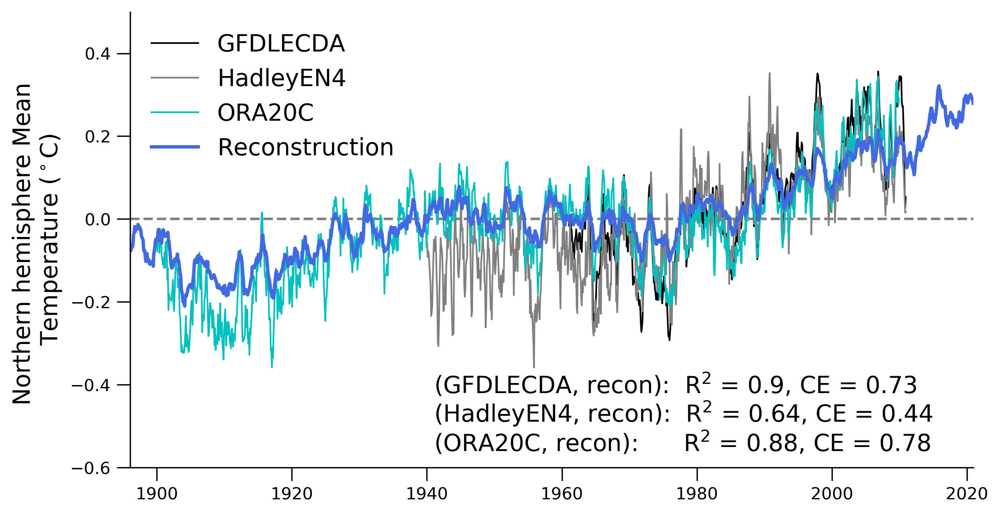

In [255]:
fig,ax = plt.subplots(1,1, figsize=(9,5))
plt.axhline(0,linestyle='--',color='gray')

ax.plot(GFDLECDA_time,GFDLECDA_nhmean_anom, color='k',label='GFDLECDA', linewidth=1)
ax.plot(HadleyEN4_time,HadleyEN4_nhmean_anom, color='gray',label='HadleyEN4', linewidth=1)
ax.plot(ORA20C_time,ORA20C_nhmean_anom, color='c',label='ORA20C',linewidth=1)

ax.plot(time, tos_recon_ensmn, 
        label='Reconstruction', color='royalblue', linewidth=2)

#ax.grid()
plt.xlim(time[45*12],time[-1])
plt.ylim(-0.6,0.5)

ax.legend(fontsize=14,frameon=False, loc='upper left')
ax.set_ylabel('Northern hemisphere Mean \nTemperature ($^\circ$C)', fontsize=14)

plt.text(time[90*12],-0.42,'(GFDLECDA, recon):  R$^2$ = '+str(np.round(corr_recon_GFDLECDA**2,2))+
         ', CE = '+str(np.round(ce_recon_GFDLECDA,2)), fontsize=14)
plt.text(time[90*12],-0.49,'(HadleyEN4, recon):  R$^2$ = '+str(np.round(corr_recon_HadleyEN4**2,2))+
         ', CE = '+str(np.round(ce_recon_HadleyEN4,2)), fontsize=14)
plt.text(time[90*12],-0.56,'(ORA20C, recon):      R$^2$ = '+str(np.round(corr_recon_ORA20C**2,2))+
         ', CE = '+str(np.round(ce_recon_ORA20C,2)), fontsize=14)

ax.tick_params(which='major', length=8)
ax.tick_params(which='minor', length=4)
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)

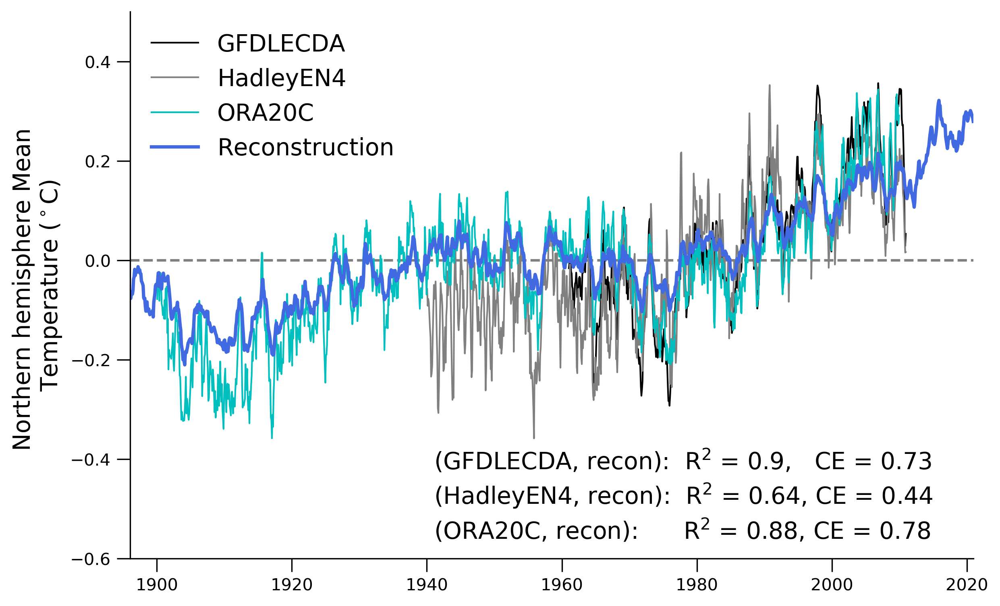

In [256]:
fig,ax = plt.subplots(1,1, figsize=(9,6))
plt.axhline(0,linestyle='--',color='gray')

ax.plot(GFDLECDA_time,GFDLECDA_nhmean_anom, color='k',label='GFDLECDA', linewidth=1)
ax.plot(HadleyEN4_time,HadleyEN4_nhmean_anom, color='gray',label='HadleyEN4', linewidth=1)
ax.plot(ORA20C_time,ORA20C_nhmean_anom, color='c',label='ORA20C',linewidth=1)

ax.plot(time, tos_recon_ensmn, 
        label='Reconstruction', color='royalblue', linewidth=2)

#ax.grid()
plt.xlim(time[45*12],time[-1])
plt.ylim(-0.6,0.5)

ax.legend(fontsize=14,frameon=False, loc='upper left')
ax.set_ylabel('Northern hemisphere Mean \nTemperature ($^\circ$C)', fontsize=14)

plt.text(time[90*12],-0.42,'(GFDLECDA, recon):  R$^2$ = '+str(np.round(corr_recon_GFDLECDA**2,2))+
         ',   CE = '+str(np.round(ce_recon_GFDLECDA,2)), fontsize=14)
plt.text(time[90*12],-0.49,'(HadleyEN4, recon):  R$^2$ = '+str(np.round(corr_recon_HadleyEN4**2,2))+
         ', CE = '+str(np.round(ce_recon_HadleyEN4,2)), fontsize=14)
plt.text(time[90*12],-0.56,'(ORA20C, recon):      R$^2$ = '+str(np.round(corr_recon_ORA20C**2,2))+
         ', CE = '+str(np.round(ce_recon_ORA20C,2)), fontsize=14)

ax.tick_params(which='major', length=8)
ax.tick_params(which='minor', length=4)
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)

### Monthly performance: 

In [35]:
tas_mean_forecast = np.mean(tot_var_forecast_all['tas'], axis=0)
tas_mean_forecast_mo = np.reshape(tas_mean_forecast,(12,nyears))

In [36]:
sia_mean_forecast = np.mean(tot_var_forecast_all['sic'], axis=0)
sia_mean_forecast_mo = np.reshape(sia_mean_forecast,(nyears,12))

In [37]:
cmap = plt.cm.get_cmap('Blues')
blah = np.arange(0.4,1,0.6/6)
blue_colors = [cmap(i) for i in blah]

cmap = plt.cm.get_cmap('Reds')
blah = np.arange(0.2,1,0.8/6)
red_colors = [cmap(i) for i in blah]

In [38]:
m

NameError: name 'm' is not defined

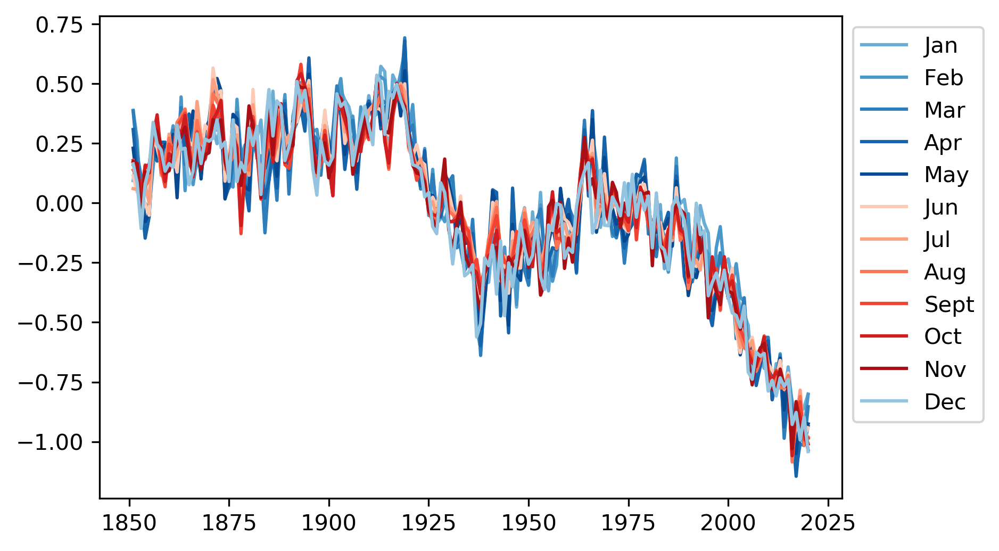

In [41]:
months = ['Jan','Feb','Mar','Apr','May','Jun','Jul','Aug','Sept','Oct','Nov','Dec']
c=0

for m in np.arange(0,12,1):
    if m<5:
        c=c+1
        plt.plot(np.arange(1851,2021,1),sia_mean_forecast_mo[:,m]*1e-6, label=months[m],color=blue_colors[c])
        if m==4: 
            c=0
    elif m == 11: 
        plt.plot(np.arange(1851,2021,1),sia_mean_forecast_mo[:,m]*1e-6, label=months[m],color=blue_colors[0])
    else: 
        plt.plot(np.arange(1851,2021,1),sia_mean_forecast_mo[:,m]*1e-6, label=months[m],color=red_colors[c])
        c=c+1

plt.legend(bbox_to_anchor=[1,1])
#plt.xlim(1985,2006)
#plt.ylim(-0.61,0.1)

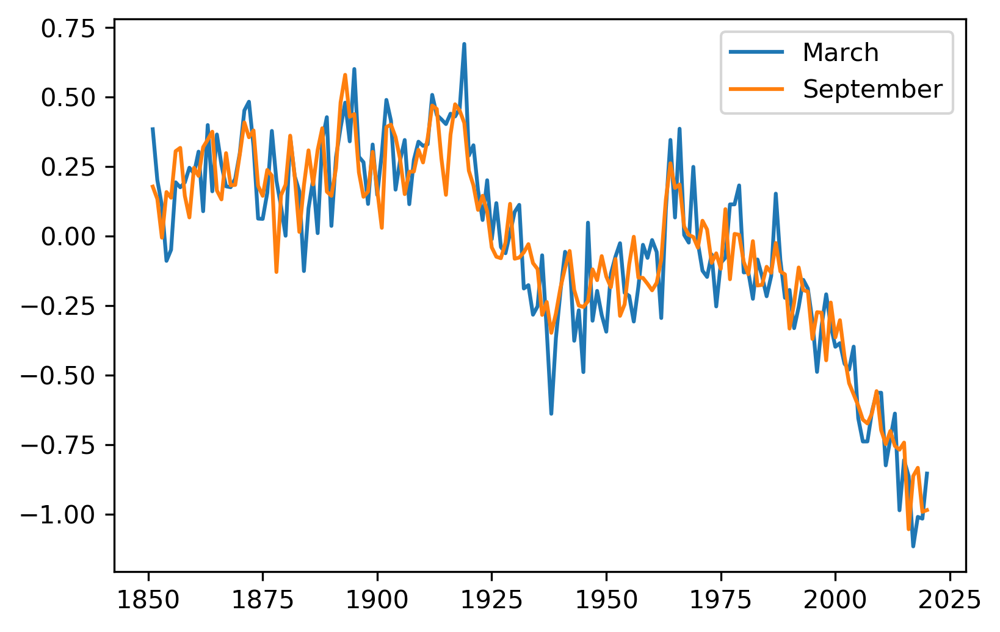

In [42]:
# plt.plot(sia_mean_forecast_mo[0,:]*1e-6, label='January')
# plt.plot(sia_mean_forecast_mo[1,:]*1e-6, label='February')
plt.plot(np.arange(1851,2021,1),sia_mean_forecast_mo[:,2]*1e-6, label='March')
# plt.plot(sia_mean_forecast_mo[3,:]*1e-6, label='April')
# plt.plot(sia_mean_forecast_mo[4,:]*1e-6, label='May')
# plt.plot(sia_mean_forecast_mo[5,:]*1e-6, label='June')
# plt.plot(sia_mean_forecast_mo[6,:]*1e-6, label='July')
# plt.plot(sia_mean_forecast_mo[7,:]*1e-6, label='August')
plt.plot(np.arange(1851,2021,1),sia_mean_forecast_mo[:,8]*1e-6, label='September')
# plt.plot(sia_mean_forecast_mo[9,:]*1e-6, label='October')
# plt.plot(sia_mean_forecast_mo[10,:]*1e-6, label='November')
# plt.plot(sia_mean_forecast_mo[11,:]*1e-6, label='December')

plt.legend(bbox_to_anchor=[1,1])

([<matplotlib.axis.YTick at 0x7f956ec71b38>,
 <a list of 12 Text yticklabel objects>)

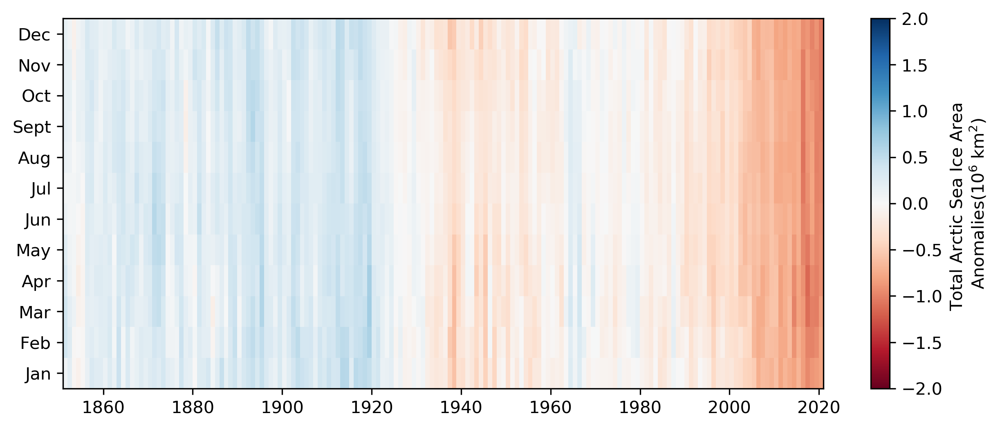

In [43]:
heat_ticks = [9,29,49,69,89,109,129,149,169]
months = ['Jan','Feb','Mar','Apr','May','Jun','Jul','Aug','Sept','Oct','Nov','Dec']

fig,ax = plt.subplots(1,1, figsize=(10,4))

plt.pcolormesh(sia_mean_forecast_mo.T*1e-6, cmap='RdBu',vmin = -2,vmax = 2)
plt.colorbar(label='Total Arctic Sea Ice Area \nAnomalies(10$^6$ km$^2$)')

plt.xticks(heat_ticks, np.array(heat_ticks)+1851)
plt.yticks(np.arange(0.5,12,1), months)

## Satellite comparison: 

In [44]:
sat_dir = '/home/disk/chaos/mkb22/Documents/SeaIceData/Observations/Fetterer_v3/'
sat_name = 'Fetterer_data_v3_adj_monthly_78_17.npz'

satdata = np.load(sat_dir+sat_name)

In [45]:
anom_start = 1979
anom_end = 2005

In [46]:
sat_years_mo = satdata['years'][1:]
sat_sia_mo = np.reshape(satdata['si_area_adj'], (39,12))
sat_sie_mo = np.reshape(satdata['si_extent'][2:-6], (39,12))
sat_sia_mo_anom = sat_sia_mo - np.nanmean(sat_sia_mo,axis=0)

sat_sia_mo_anom_comp = sat_sia_mo - np.nanmean(sat_sia_mo,axis=0)
sat_years_mo_comp = sat_years_mo

In [47]:
[fet_sia_anom, fet_sia_anom_adj, fet_sie_anom, fet_time] = oda.load_annual_satellite_anom(2005)

In [52]:
sia_mean_forecast_mo[(recon_yrs>=anom_start)&(recon_yrs<=2017),:].shape

(39, 12)

In [53]:
sia_mean_forecast_mo.shape

(170, 12)

In [54]:
recon_sia_ensmn = np.nanmean(sia_mean_forecast_mo,axis=1)*1e-6
recon_yrs = np.arange(1851,2021,1)

sat_ind = (recon_yrs>=anom_start)&(recon_yrs<=anom_end)
sat_ind_full = (recon_yrs>=anom_start)&(recon_yrs<=2017)

recon_sia_ensmn_anom = recon_sia_ensmn - np.nanmean(recon_sia_ensmn[sat_ind])

In [55]:
recon_sia_anom_comp = recon_sia_ensmn_anom[sat_ind_full]
recon_sia_comp_2d = sia_mean_forecast_mo[(recon_yrs>=anom_start)&(recon_yrs<=2017),:]

recon_sia_comp_anom_2d = recon_sia_comp_2d - np.nanmean(recon_sia_comp_2d,axis=0)

In [56]:
recon_sia_anom_comp = sia_mean_forecast_mo[-42:-3,:] - np.nanmean(sia_mean_forecast_mo[-42:-3,:],axis=0)
recon_sia_anom_mo = sia_mean_forecast_mo - np.nanmean(sia_mean_forecast_mo[-42:-3,:],axis=0)

In [57]:
recon_dir = '/home/disk/p/mkb22/Documents/si_analysis_kb/common_era_experiments/data/'
recon_file_ccsm4 = 'Brennan_and_Hakim_2021_CCSM4_model_prior_reconstructions_nh.nc'
recon_file_mpi = 'Brennan_and_Hakim_2021_MPI_model_prior_reconstructions_nh.nc'

recon_data_ccsm4 = xr.open_dataset(recon_dir+recon_file_ccsm4)
recon_data_mpi = xr.open_dataset(recon_dir+recon_file_mpi)

In [58]:
sie_ensmn_anom_ccsm4 = recon_data_ccsm4.si_extent_ensemble_mean_anomalies.values
sie_ccsm4_97_5_anom = recon_data_ccsm4.si_extent_97_5_percentiles.values
sie_ccsm4_2_5_anom = recon_data_ccsm4.si_extent_2_5_percentiles.values

sia_ensmn_anom_ccsm4 = recon_data_ccsm4.si_area_ensemble_mean_anomalies.values
sia_ccsm4_97_5_anom = recon_data_ccsm4.si_area_97_5_percentiles.values
sia_ccsm4_2_5_anom = recon_data_ccsm4.si_area_2_5_percentiles.values
recon_years = recon_data_ccsm4.time.values

In [59]:
sie_ensmn_anom_mpi = recon_data_mpi.si_extent_ensemble_mean_anomalies.values
sie_mpi_97_5_anom = recon_data_mpi.si_extent_97_5_percentiles.values
sie_mpi_2_5_anom = recon_data_mpi.si_extent_2_5_percentiles.values
recon_years_mpi = recon_data_mpi.time.values

sia_ensmn_anom_mpi = recon_data_mpi.si_area_ensemble_mean_anomalies.values
sia_mpi_97_5_anom = recon_data_mpi.si_area_97_5_percentiles.values
sia_mpi_2_5_anom = recon_data_mpi.si_area_2_5_percentiles.values
recon_years = recon_data_ccsm4.time.values

In [60]:
# LOAD ANNUAL WALSH DATA: 
[walsh_sia, walsh_sie, walsh_time] = load_annual_walsh(version=2)

walsh_sia_anom = find_anomalies(walsh_time, walsh_sia, anom_start,anom_end)
walsh_sie_anom = find_anomalies(walsh_time, walsh_sie, anom_start,anom_end)

In [61]:
inf_list = [1.8,1.9,2.0,2.1,2.2,2.3,2.4]
corr_sat_recon_annual = np.zeros((len(inf_list)))
ce_sat_recon_annual = np.zeros((len(inf_list)))

for i,inf in enumerate(inf_list):
    [corr_sat_recon_annual[i], 
     ce_sat_recon_annual[i]] = oda.calc_corr_ce(fet_sia_anom_adj,
                                                np.nanmean(recon_sia_anom_comp,axis=1)*1e-6*inf)

In [62]:
fet_sia_anom_adj.shape,np.nanmean(recon_sia_anom_comp,axis=1).shape

((39,), (39,))

In [63]:
[corr_sat_recon_annual, 
 ce_sat_recon_annual] = oda.calc_corr_ce(fet_sia_anom_adj,np.nanmean(recon_sia_anom_comp,axis=1)*1e-6)

In [64]:
[corr_Bren_recon_annual,
 ce_Bren_recon_annual] = oda.calc_corr_ce(sia_ensmn_anom_ccsm4[(recon_years>=1851)],
                                          recon_sia_ensmn_anom[(recon_yrs<=1999)])

In [65]:
[corr_walsh_recon_annual, 
 ce_walsh_recon_annual] = oda.calc_corr_ce(walsh_sia_anom[1:],recon_sia_ensmn_anom[(recon_yrs<=2017)])

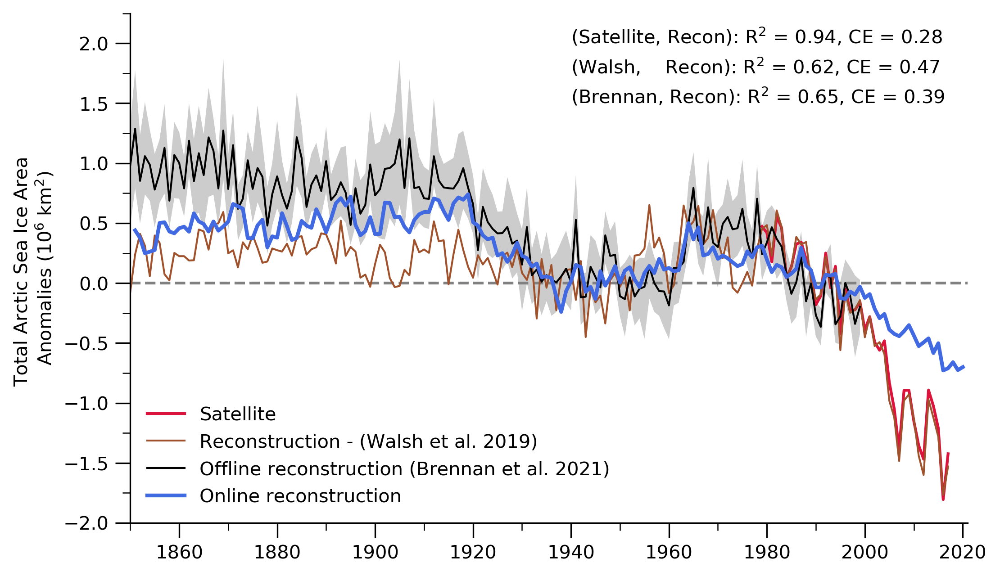

In [66]:
fig,ax = plt.subplots(1,figsize=(8,5))
plt.axhline(0,linestyle='--',color='gray')

plt.plot(fet_time,fet_sia_anom_adj, color='crimson', label='Satellite')

plt.plot(walsh_time,walsh_sia_anom,
         label='Reconstruction - (Walsh et al. 2019)', color='sienna',
         linewidth=1)
plt.plot(recon_years,sia_ensmn_anom_ccsm4,color='k',#'#8756e4',
         label='Offline reconstruction (Brennan et al. 2021)',linewidth=1)

plt.fill_between(recon_years,sia_ccsm4_2_5_anom,sia_ccsm4_97_5_anom,
                 alpha=0.2, color='k',linewidth=0.01)

plt.plot(np.arange(1851,2021,1),recon_sia_ensmn_anom, 
         color='royalblue', label='Online reconstruction', linewidth=2)

plt.legend(loc='lower left', frameon=False)
plt.ylabel('Total Arctic Sea Ice Area \nAnomalies (10$^6$ km$^2$)')

plt.text(1940,2.0,('(Satellite, Recon): R$^2$ = '+str(np.round(corr_sat_recon_annual**2,2))+
         ', CE = '+str(np.round(ce_sat_recon_annual,2))))
plt.text(1940,1.75,('(Walsh,    Recon): R$^2$ = '+str(np.round(corr_walsh_recon_annual**2,2))+
         ', CE = '+str(np.round(ce_walsh_recon_annual,2))))
plt.text(1940,1.5,('(Brennan, Recon): R$^2$ = '+str(np.round(corr_Bren_recon_annual**2,2))+
         ', CE = '+str(np.round(ce_Bren_recon_annual,2))))

plt.xlim(1850,2021)
plt.ylim(-2,2.25)
#plt.title('Annual Comparison')

# plt.axvline(1917)
# plt.axvline(1938)

ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)

ax.yaxis.set_minor_locator(MultipleLocator(0.25))
ax.xaxis.set_minor_locator(MultipleLocator(10))
ax.tick_params(which='major', length=8)
ax.tick_params(which='minor', length=4)

NameError: name 'corr_sat_recon_mo' is not defined

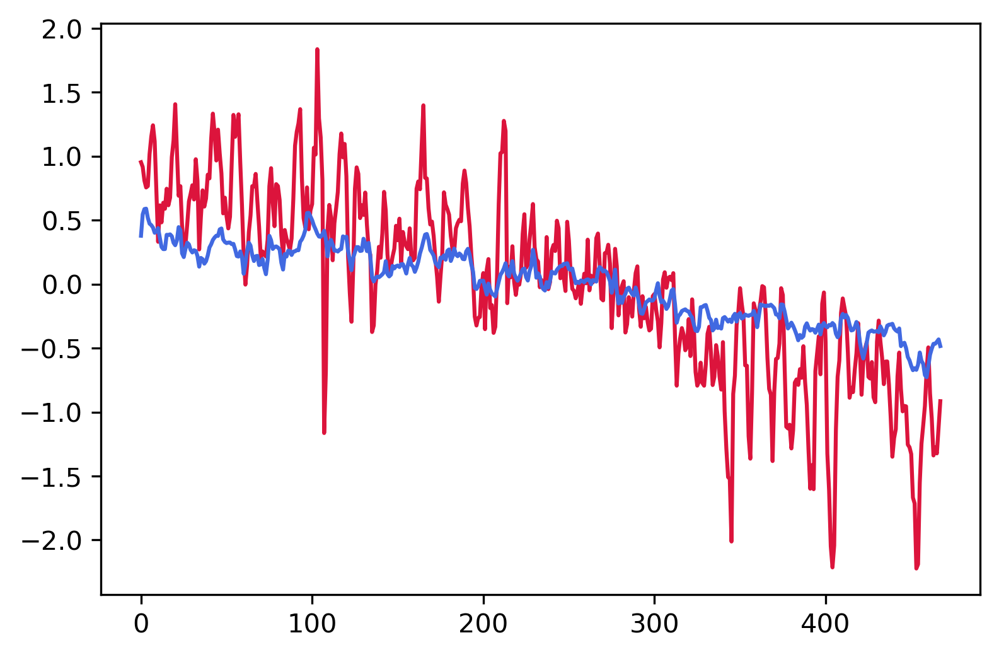

In [67]:
plt.plot(sat_sia_mo_anom_comp.flatten(),color='crimson', label='Satellite')
plt.plot(recon_sia_anom_comp.flatten()*1e-6,color='royalblue', label='Online reconstruction')

plt.text(1,-2.1,('R$^2$ = '+str(np.round(corr_sat_recon_mo**2,2))+', CE = '+str(np.round(ce_sat_recon_mo,2))))

In [68]:
sat_time = np.array([datetime.datetime(y, m, 15) for y in np.arange(1979,2018,1) for m in np.arange(1,13,1)])
sat_time.shape

(468,)

In [69]:
walsh_years, walsh_sia_mo, walsh_sie_mo = load_monthly_walsh()

walsh_sia_anom_mo = walsh_sia_mo - np.nanmean(walsh_sia_mo,axis=0)[np.newaxis,:]

walsh_timemo = np.array([datetime.datetime(y, m, 15) for y in np.arange(1850,2014,1) for m in np.arange(1,13,1)])
walsh_timemo.shape

(1968,)

In [70]:
[corr_sat_recon_mo, 
 ce_sat_recon_mo] = oda.calc_corr_ce(sat_sia_mo_anom_comp.flatten(),recon_sia_comp_anom_2d.flatten()*1e-6)

corr_sat_recon_mo**2, ce_sat_recon_mo

(0.746080688094052, 0.5279560924934912)

In [71]:
walsh_sia_anom_mo.flatten().shape

(1968,)

In [72]:
[corr_walsh_recon_mo, 
 ce_walsh_recon_mo] = oda.calc_corr_ce(walsh_sia_anom_mo.flatten(),recon_sia_anom_mo.flatten()[:1968]*1e-6)

corr_walsh_recon_mo**2, ce_walsh_recon_mo

(0.11809638901092687, -0.41094572006222263)

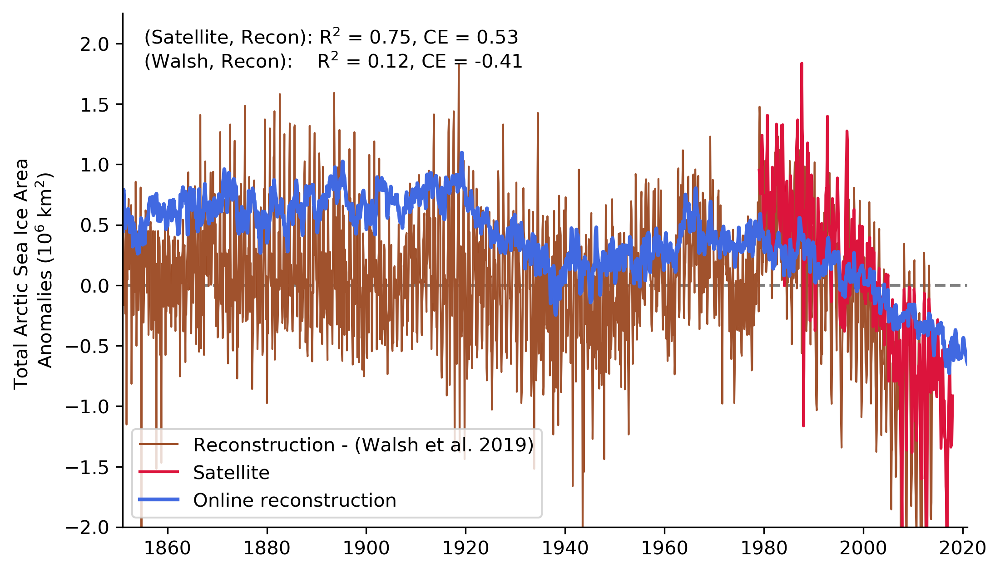

In [73]:
fig,ax = plt.subplots(1,figsize=(8,5))
plt.axhline(0,linestyle='--',color='gray')


plt.plot(walsh_timemo,walsh_sia_anom_mo.flatten(),
         label='Reconstruction - (Walsh et al. 2019)', color='sienna',
         linewidth=1)

plt.plot(sat_time,sat_sia_mo_anom_comp.flatten(), color='crimson', label='Satellite')
# plt.plot(recon_years,sia_ensmn_anom_ccsm4,color='k',#'#8756e4',
#          label='Offline reconstruction (Brennan et al. 2021)',linewidth=1)

# plt.fill_between(recon_years,sia_ccsm4_2_5_anom,sia_ccsm4_97_5_anom,
#                  alpha=0.2, color='k',linewidth=0.01)

plt.plot(time,recon_sia_anom_mo.flatten()*1e-6, 
         color='royalblue', label='Online reconstruction', linewidth=2)

plt.legend(loc='lower left')#, frameon=False)
plt.ylabel('Total Arctic Sea Ice Area \nAnomalies (10$^6$ km$^2$)')

plt.text(time[50],2.0,('(Satellite, Recon): R$^2$ = '+str(np.round(corr_sat_recon_mo**2,2))+
         ', CE = '+str(np.round(ce_sat_recon_mo,2))))
plt.text(time[50],1.8,('(Walsh, Recon):    R$^2$ = '+str(np.round(corr_walsh_recon_mo**2,2))+
         ', CE = '+str(np.round(ce_walsh_recon_mo,2))))

plt.xlim(time[0],time[-1])
plt.ylim(-2,2.25)
#plt.title('Annual Comparison')

# plt.axvline(1917)
# plt.axvline(1938)

ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)

# ax.yaxis.set_minor_locator(MultipleLocator(0.25))
# ax.xaxis.set_minor_locator(MultipleLocator(10))
# ax.tick_params(which='major', length=8)
# ax.tick_params(which='minor', length=4)

In [105]:
slope_2020_list = []
slope_1917_list = []

In [106]:
recon_sia_ensmn_anom_slopes = recon_sia_ensmn_anom#[:-20]

In [107]:
np.arange(1851,2021,1)[-length:].shape, recon_sia_ensmn_anom_slopes[-length:].shape

((40,), (40,))

In [108]:
np.arange(1851,2021,1)[66:66+length].shape, recon_sia_ensmn_anom_slopes[66:66+length].shape

((40,), (40,))

In [109]:
length_list = np.arange(10,41,1)

for length in length_list:
    slope_2020, intercept_2020,_,_,_ = stats.linregress(np.arange(1851,2021,1)[-length:],
                                                        recon_sia_ensmn_anom_slopes[-length:])
    slope_2020_list.append(slope_2020)
    
    slope_1917, intercept_1917,_,_,_ = stats.linregress(np.arange(1851,2021,1)[66:66+length],
                                                        recon_sia_ensmn_anom_slopes[66:66+length])
    slope_1917_list.append(slope_1917)

In [110]:
np.array(length_list).shape, np.array(slope_2020_list).shape

((31,), (31,))

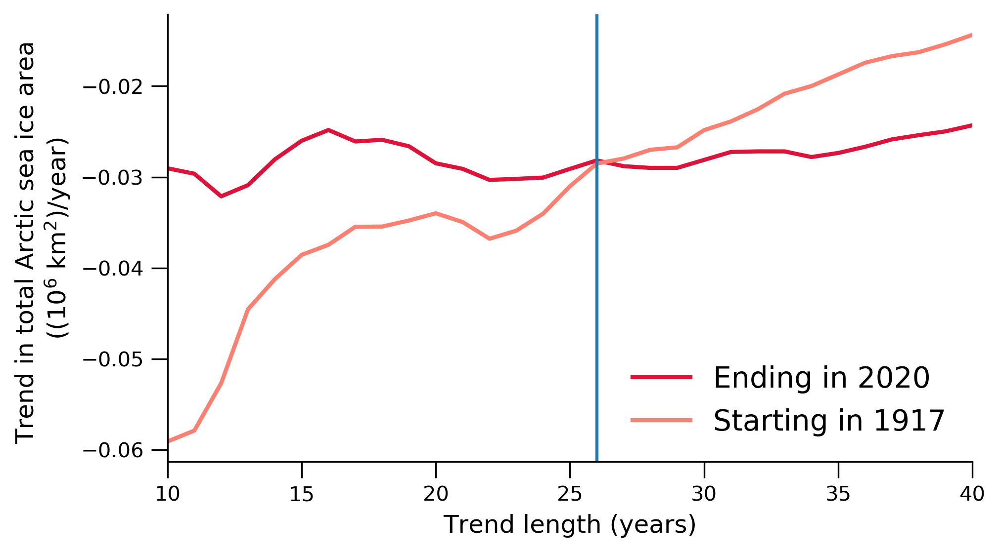

In [113]:
fig,ax = plt.subplots(1,figsize=(7,4))
#plt.axvline(25, color='gray', linestyle='--')

plt.plot(np.array(length_list), np.array(slope_2020_list), color='crimson',linewidth=2, label='Ending in 2020')
plt.plot(np.array(length_list), np.array(slope_1917_list), color='salmon',linewidth=2, label='Starting in 1917')

plt.legend(loc='lower right',frameon=False, fontsize=14)

plt.ylabel('Trend in total Arctic sea ice area \n((10$^6$ km$^2$)/year)', fontsize=12)
plt.xlabel('Trend length (years)', fontsize=12)

plt.xlim(10,40)


ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)

plt.axvline(26)

ax.yaxis.set_minor_locator(MultipleLocator(0.25))
ax.xaxis.set_minor_locator(MultipleLocator(10))
ax.tick_params(which='major', length=8)
ax.tick_params(which='minor', length=4)

In [114]:
sit_recon_ensmn_mo = np.mean(tot_var_forecast_all['sit'], axis=0)

sit_recon_ensmn = np.mean(np.reshape(sit_recon_ensmn_mo,(170,12)),axis=1)
sit_recon_ensmn_slopes = sit_recon_ensmn#[:-20]

In [115]:
slope_2020_list = []
slope_1917_list = []
length_list = np.arange(10,41,1)

for length in length_list:
    slope_2020, intercept_2020,_,_,_ = stats.linregress(np.arange(1851,2021,1)[-length:],
                                                        sit_recon_ensmn_slopes[-length:])
    slope_2020_list.append(slope_2020)
    
    slope_1917, intercept_1917,_,_,_ = stats.linregress(np.arange(1851,2021,1)[66:66+length],
                                                                  sit_recon_ensmn_slopes[66:66+length])
    slope_1917_list.append(slope_1917)

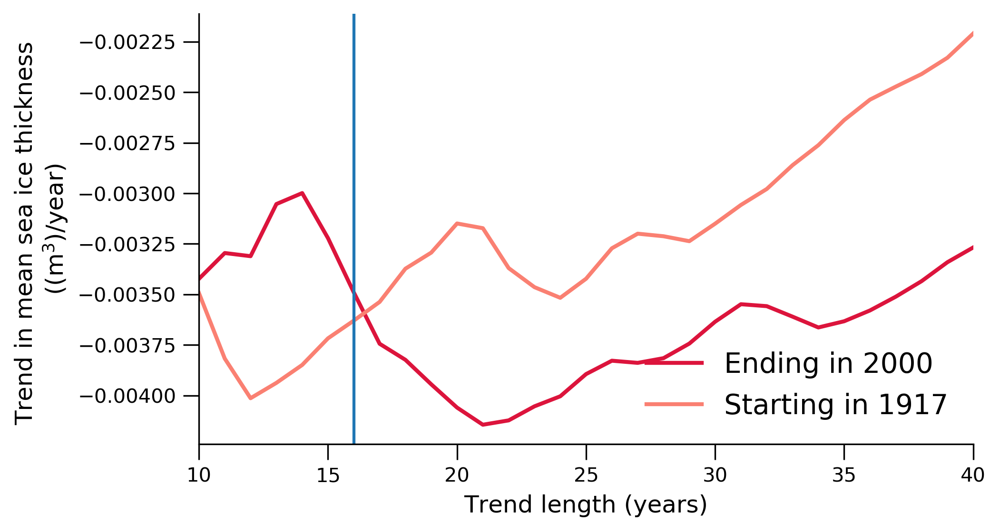

In [118]:
fig,ax = plt.subplots(1,figsize=(7,4))
#plt.axvline(25, color='gray', linestyle='--')

plt.plot(np.array(length_list), np.array(slope_2020_list), color='crimson',linewidth=2, label='Ending in 2000')
plt.plot(np.array(length_list), np.array(slope_1917_list), color='salmon',linewidth=2, label='Starting in 1917')

plt.legend(loc='lower right',frameon=False, fontsize=14)

plt.ylabel('Trend in mean sea ice thickness \n((m$^3$)/year)', fontsize=12)
plt.xlabel('Trend length (years)', fontsize=12)

plt.xlim(10,40)

ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)

plt.axvline(16)

ax.yaxis.set_minor_locator(MultipleLocator(0.25))
ax.xaxis.set_minor_locator(MultipleLocator(10))
ax.tick_params(which='major', length=8)
ax.tick_params(which='minor', length=4)

In [121]:
slope_2020, intercept_2020, r, p, se = stats.linregress(np.arange(1851,2021,1)[-length:],
                                                        recon_sia_ensmn_anom[-length:])
slope_2020_list.append(slope_2020)

In [122]:
slope_1917, intercept_1917, r, p, se = stats.linregress(np.arange(1851,2021,1)[66:66+length],
                                                                  recon_sia_ensmn_anom[66:66+length])
slope_1917_list.append(slope_1917)

In [205]:
slope_1917_1936, intercept_1917_1936, r, p, se = stats.linregress(np.arange(1851,2021,1)[67:67+length],
                                                                  recon_sia_ensmn_anom[67:67+length])
slope_1917_1936

-0.01250020243781132

In [206]:
slope_1917_1936, intercept_1917_1936, r, p, se = stats.linregress(np.arange(1851,2021,1)[68:68+length],
                                                                  recon_sia_ensmn_anom[68:68+length])
slope_1917_1936

-0.010175730133925207

In [207]:
np.arange(1851,2021,1)[68:68+21]

array([1919, 1920, 1921, 1922, 1923, 1924, 1925, 1926, 1927, 1928, 1929,
       1930, 1931, 1932, 1933, 1934, 1935, 1936, 1937, 1938, 1939])

Text(0.5, 1.0, 'Annual Comparison')

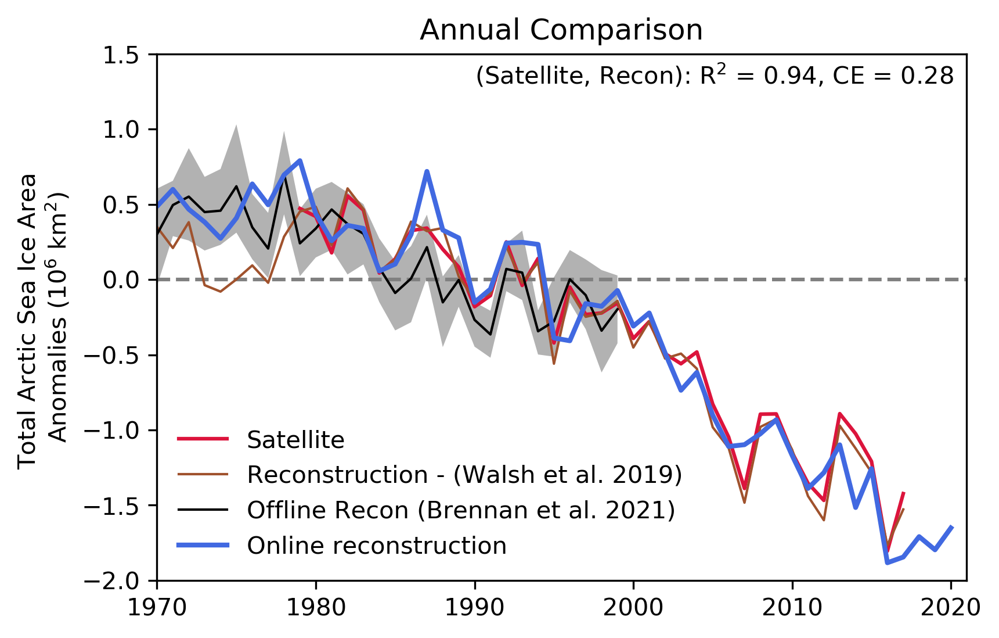

In [210]:
plt.axhline(0,linestyle='--',color='gray')

plt.plot(fet_time,fet_sia_anom_adj, color='crimson', label='Satellite')

plt.plot(walsh_time,walsh_sia_anom,
         label='Reconstruction - (Walsh et al. 2019)', color='sienna',
         linewidth=1)
plt.plot(recon_years,sia_ensmn_anom_ccsm4,color='k',#'#8756e4',
         label='Offline Recon (Brennan et al. 2021)',linewidth=1)

plt.fill_between(recon_years,sia_ccsm4_2_5_anom,sia_ccsm4_97_5_anom,
                 alpha=0.3, color='k',linewidth=0.01)

plt.plot(np.arange(1851,2021,1),recon_sia_ensmn_anom*2.5, 
         color='royalblue', label='Online reconstruction', linewidth=2)

plt.legend(loc='lower left', frameon=False)
plt.ylabel('Total Arctic Sea Ice Area \nAnomalies (10$^6$ km$^2$)')

plt.text(1990,1.3,('(Satellite, Recon): R$^2$ = '+str(np.round(corr_sat_recon_annual**2,2))+
         ', CE = '+str(np.round(ce_sat_recon_annual,2))))

plt.xlim(1970,2021)
plt.ylim(-2,1.5)
plt.title('Annual Comparison')

In [901]:
slope, intercept, r, p, se = scipy.stats.linregress(x,y)

NameError: name 'scipy' is not defined

In [127]:
import matplotlib
sat_sia_mo_anom_comp[8,11] = np.nan
sat_sia_mo_anom_comp[9,0] = np.nan

current_cmap = matplotlib.cm.RdBu
current_cmap.set_bad(color='gray')

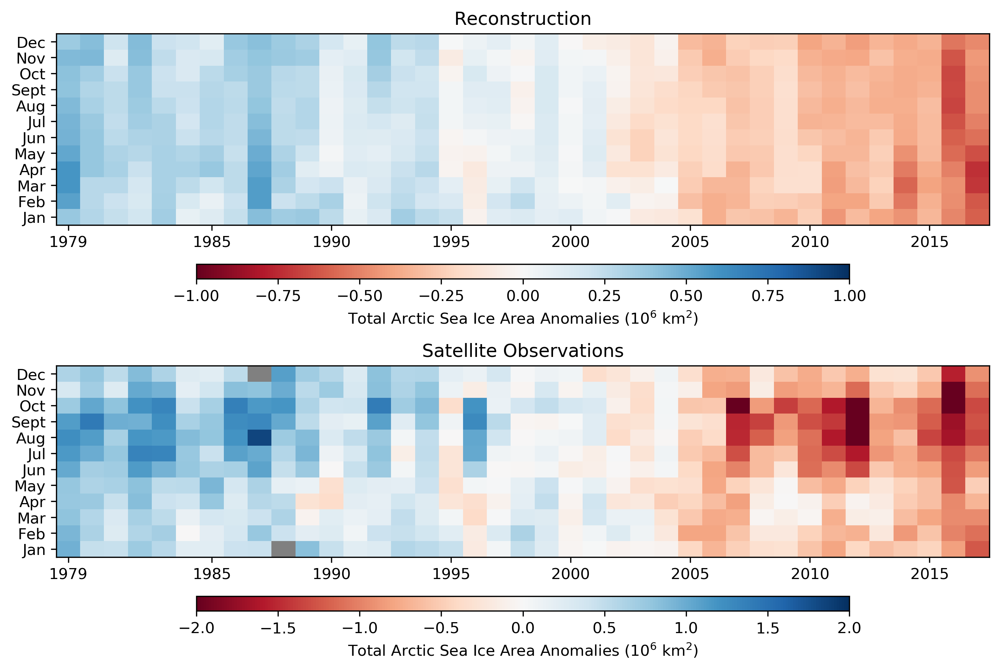

In [128]:
heat_ticks = [0.5,6.5,11.5,16.5,21.5,26.5,31.5,36.5]
heat_labels = [int(i) for i in (np.array(heat_ticks)+1978.5)]
months = ['Jan','Feb','Mar','Apr','May','Jun','Jul','Aug','Sept','Oct','Nov','Dec']

fig,axs = plt.subplots(2,1, figsize=(9,6),constrained_layout=True)
ax = axs.flatten()

cs1 = ax[0].pcolormesh(recon_sia_comp_anom_2d.T*1e-6, cmap='RdBu',vmin=-1,vmax=1)
cs2 = ax[1].pcolormesh(sat_sia_mo_anom_comp.T, cmap=current_cmap,vmin=-2,vmax=2)

plt.colorbar(cs2,ax=ax[1],orientation='horizontal', shrink=0.7,aspect=30,
             label='Total Arctic Sea Ice Area Anomalies (10$^6$ km$^2$)')
plt.colorbar(cs1,ax=ax[0],orientation='horizontal', shrink=0.7,aspect=30,
             label='Total Arctic Sea Ice Area Anomalies (10$^6$ km$^2$)')

# plt.colorbar(cs1, ax=ax[0],label='Total Arctic Sea Ice Area \nAnomalies (10$^6$ km$^2$)')
# plt.colorbar(cb1, orientation='horizontal', shrink=0.8, ax=ax[6])

ax[0].set_xticklabels(heat_labels)
ax[0].set_xticks(heat_ticks)
ax[0].set_yticklabels(months)
ax[0].set_yticks(np.arange(0.5,12,1))
ax[1].set_xticklabels(heat_labels)
ax[1].set_xticks(heat_ticks)
ax[1].set_yticklabels(months)
ax[1].set_yticks(np.arange(0.5,12,1))

ax[0].set_title('Reconstruction')
ax[1].set_title('Satellite Observations')

savename ='figures/sia_recon_sat_comparison_heatmap.png'
#plt.savefig(savename)

In [129]:
[corr_sat_recon_mo, 
 ce_sat_recon_mo] = oda.calc_corr_ce(sat_sia_mo_anom_comp.flatten(),recon_sia_comp_anom_2d.flatten()*1e-6)

corr_sat_recon_mo**2, ce_sat_recon_mo

(nan, 0.5392118152694565)

In [130]:
sat_sia_mo_anom_comp.shape

(39, 12)

Text(1, -2.1, 'R$^2$ = nan, CE = 0.54')

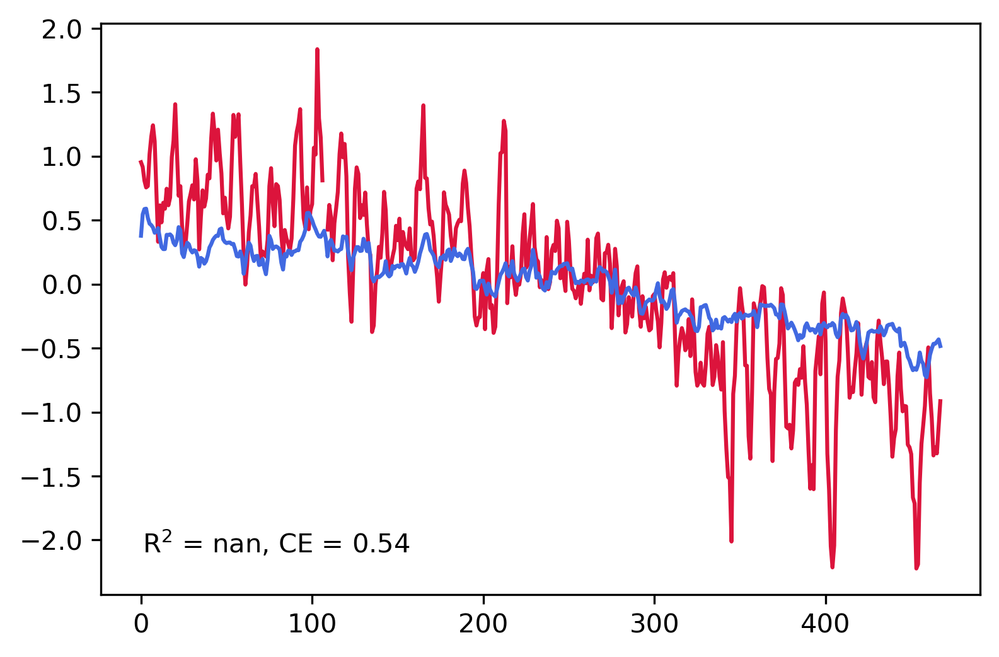

In [131]:
plt.plot(sat_sia_mo_anom_comp.flatten(),color='crimson', label='Satellite')
plt.plot(recon_sia_anom_comp.flatten()*1e-6,color='royalblue', label='Online reconstruction')

plt.text(1,-2.1,('R$^2$ = '+str(np.round(corr_sat_recon_mo**2,2))+', CE = '+str(np.round(ce_sat_recon_mo,2))))

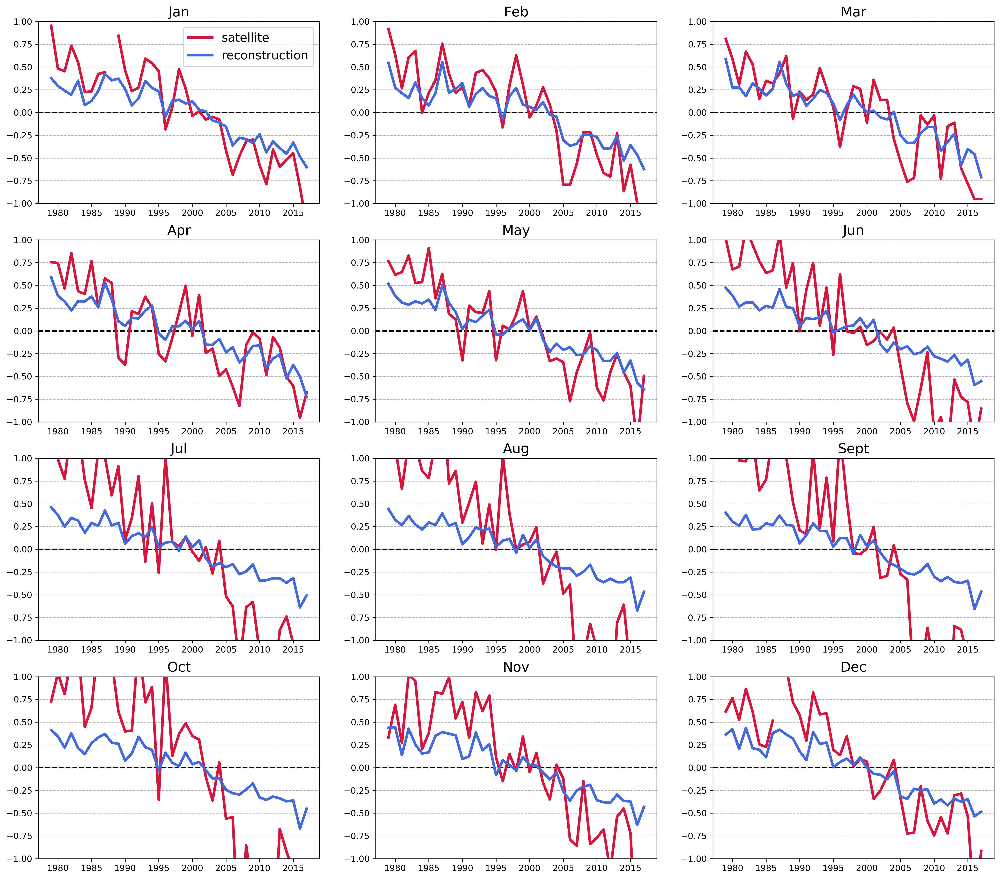

In [132]:
fig,axs = plt.subplots(4,3, figsize=(20,18))
ax=axs.flatten()

for i in range(12):
    ax[i].axhline(0, color='k',linestyle='--')
    ax[i].plot(sat_years_mo_comp,sat_sia_mo_anom_comp[:,i], label='satellite',
               color='crimson', linewidth=3)
    ax[i].plot(sat_years_mo_comp,recon_sia_anom_comp[:,i]*1e-6, label='reconstruction',
               color='royalblue', linewidth=3)
    ax[i].set_title(months[i], fontsize=16)
    ax[i].set_ylim(-1,1)
    
    ax[i].grid(linestyle='--',axis='y')
    
ax[0].legend(fontsize=14)

(686671.0, 703106.0)

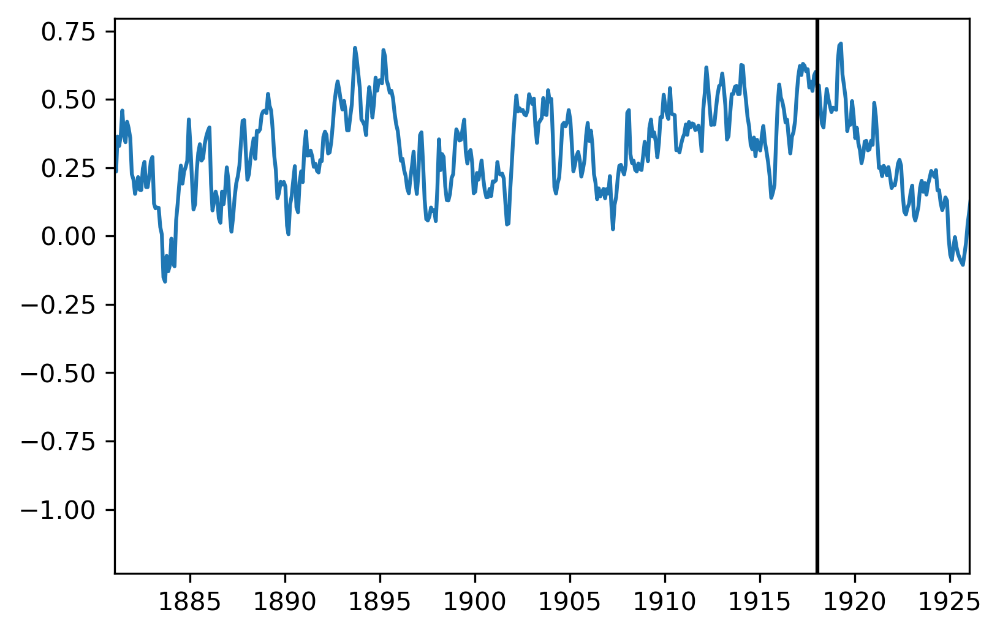

In [1035]:
plt.plot(time,np.mean(tot_var_forecast_all['sic'],axis=0)*1e-6)
plt.axvline(time[67*12],color='k')
plt.xlim(time[30*12],time[75*12])

In [1031]:
time[67*12]

datetime.datetime(1918, 1, 15, 0, 0)

## Spatial patterns: 

In [1287]:
from cartopy.util import add_cyclic_point

In [1288]:
var='sit'

lat = LIMd['var_dict'][var]['lat']
lon = LIMd['var_dict'][var]['lon']

ens_mean = np.nanmean(Xa_dcomp_all[var],axis=0)
ens_mean_3d = np.reshape(ens_mean,(lat.shape[0],lon.shape[0],ens_mean.shape[1]))
etcw = np.nanmean(ens_mean_3d[:,:,etcw_ind],axis=2)

In [1342]:
time[66*12]

datetime.datetime(1917, 1, 15, 0, 0)

In [1340]:
ens_mean_4d = np.reshape(ens_mean_3d,(27,144,170,12))
ens_mean_anom_4d = ens_mean_4d - np.nanmean(ens_mean_4d,axis=3)[:,:,:,np.newaxis]

In [1415]:
jan1900 = time[49*12]
jan1907 = time[56*12]
jan1910 = time[59*12]
jan1917 = time[66*12]
jan1920 = time[69*12]
jan1930 = time[79*12]
jan1940 = time[89*12]
before_etcw_ind_20 = (time<jan1920)&(time>=jan1900)
before_etcw_ind_10 = (time<jan1910)&(time>=jan1900)
anom_period = (time<jan1910)&(time>=jan1900)
etcw_ind_20 = (time<jan1940)&(time>=jan1920)
etcw_ind_10_1 = (time<jan1930)&(time>=jan1920)
etcw_ind_10_2 = (time<jan1940)&(time>=jan1930)

In [1408]:
np.nanmean(ens_mean_3d[:,:,before_etcw_ind],axis=2).shape

(27, 144)

In [1409]:
before_etcw_mn = np.nanmean(ens_mean_3d[:,:,before_etcw_ind])
etcw_mn = np.nanmean(ens_mean_3d[:,:,etcw_ind])
before_etcw = ens_mean_3d[:,:,before_etcw_ind]
etcw = ens_mean_3d[:,:,etcw_ind]

In [1410]:
# fig,axs = plt.subplots(4,3, figsize=(8,10), constrained_layout=True,
#                        subplot_kw={'projection':ccrs.NorthPolarStereo()})
# ax = axs.flatten()

# var = 'sic'
# yr = 86

# for t in range(12): 
#     lat = LIMd['var_dict'][var]['lat']
#     lon = LIMd['var_dict'][var]['lon']

#     plot = ens_mean_anom_4d[:,:,yr,t]
# #    limit = max(np.nanmax(plot), np.abs(np.nanmin(plot)))
#     limit = 0.25
    
#     wrap_etcw, wrap_lon = add_cyclic_point(plot, coord=lon)
    
#     ax[t].coastlines()
#     ax[t].gridlines()
    
#     theta = np.linspace(0, 2*np.pi, 100)
#     center, radius = [0.5, 0.5], 0.5
#     verts = np.vstack([np.sin(theta), np.cos(theta)]).T
#     circle = mpath.Path(verts * radius + center)

#     ax[t].set_boundary(circle, transform=ax[t].transAxes)
#     ax[t].set_extent([-180, 180, 90, 50], crs=ccrs.PlateCarree())
#     cb1 = ax[t].pcolormesh(wrap_lon,lat,wrap_etcw,
#                            cmap='RdBu_r',transform=ccrs.PlateCarree(), 
#                            vmin = -limit, vmax=limit)
#     ax[t].set_title(month_names[t], fontsize=14)

# plt.colorbar(cb1, ax=ax[t])

# plt.suptitle(str(yr+1851), fontsize=16)

In [1411]:
# fig,axs = plt.subplots(4,3, figsize=(8,10), constrained_layout=True,
#                        subplot_kw={'projection':ccrs.NorthPolarStereo()})
# ax = axs.flatten()

# var = 'sic'
# startt = 0

# for t in range(12): 
#     lat = LIMd['var_dict'][var]['lat']
#     lon = LIMd['var_dict'][var]['lon']

#     plot = etcw[:,:,startt+t]
# #    limit = max(np.nanmax(plot), np.abs(np.nanmin(plot)))
#     limit = 0.25
    
#     wrap_etcw, wrap_lon = add_cyclic_point(plot, coord=lon)
    
#     ax[t].coastlines()
#     ax[t].gridlines()
    
#     theta = np.linspace(0, 2*np.pi, 100)
#     center, radius = [0.5, 0.5], 0.5
#     verts = np.vstack([np.sin(theta), np.cos(theta)]).T
#     circle = mpath.Path(verts * radius + center)

#     ax[t].set_boundary(circle, transform=ax[t].transAxes)
#     ax[t].set_extent([-180, 180, 90, 50], crs=ccrs.PlateCarree())
#     cb1 = ax[t].pcolormesh(wrap_lon,lat,wrap_etcw,
#                            cmap='RdBu_r',transform=ccrs.PlateCarree(), 
#                            vmin = -limit, vmax=limit)
#     ax[t].set_title(month_names[t], fontsize=14)

# #plt.colorbar(cb1, ax=ax[t])

# plt.suptitle('1917', fontsize=16)

Text(0.5, 0.98, 'ETCW mean (1920-1940 CE)')

/home/disk/chaos/mkb22/anaconda2/envs/lims_update/lib/python3.6/site-packages/IPython/core/events.py:88: UserWarning: constrained_layout not applied.  At least one axes collapsed to zero width or height.
  func(*args, **kwargs)


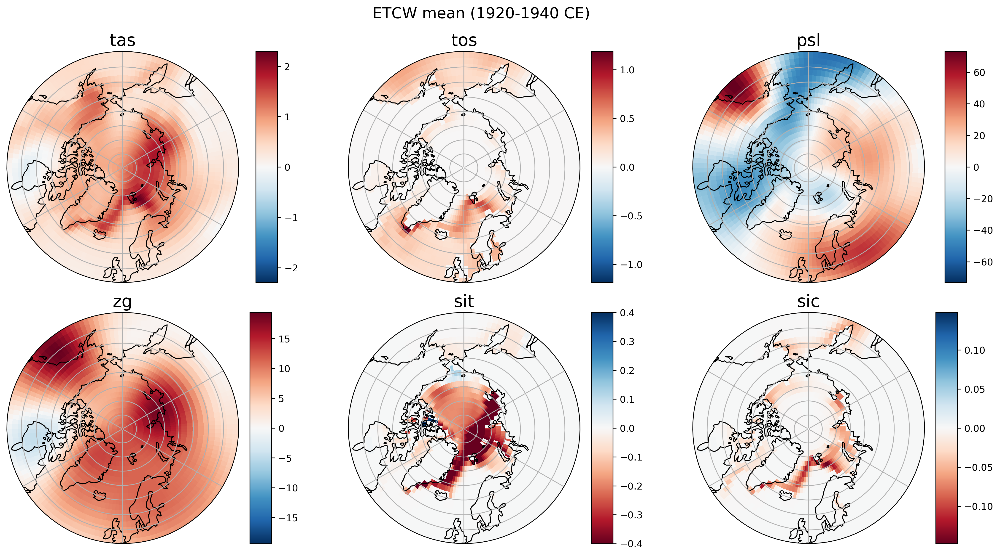

In [1416]:
#fig = plt.figure(2, figsize=(14, 18))
cmap_list = ['RdBu_r','RdBu_r','RdBu_r','RdBu_r','RdBu','RdBu']

fig,axs = plt.subplots(2,3, figsize=(15,8), constrained_layout=True,
                       subplot_kw={'projection':ccrs.NorthPolarStereo()})
ax = axs.flatten()
pltv = np.arange(4,8,1)

for v,var in enumerate(['tas','tos','psl','zg','sit','sic']):
    lat = LIMd['var_dict'][var]['lat']
    lon = LIMd['var_dict'][var]['lon']

    ens_mean = np.nanmean(Xa_dcomp_all[var],axis=0)
    ens_mean_3d = np.reshape(ens_mean,(lat.shape[0],lon.shape[0],ens_mean.shape[1]))
    
    mn = np.nanmean(ens_mean_3d[:,:,anom_period],axis=2)

    etcw = np.nanmean(ens_mean_3d[:,:,etcw_ind_20],axis=2) - mn
    
    if 'sit' in var: 
        limit = 0.4
    else: 
        limit = max(np.nanmax(etcw), np.abs(np.nanmin(etcw)))
    
    wrap_etcw, wrap_lon = add_cyclic_point(etcw, coord=lon)
    
    ax[v].coastlines()
    ax[v].gridlines()
    
    theta = np.linspace(0, 2*np.pi, 100)
    center, radius = [0.5, 0.5], 0.5
    verts = np.vstack([np.sin(theta), np.cos(theta)]).T
    circle = mpath.Path(verts * radius + center)

    ax[v].set_boundary(circle, transform=ax[v].transAxes)
    ax[v].set_extent([-180, 180, 90, 50], crs=ccrs.PlateCarree())
    cb1 = ax[v].pcolormesh(wrap_lon,lat,wrap_etcw,
                           cmap=cmap_list[v],transform=ccrs.PlateCarree(), 
                           vmin = -limit, vmax=limit)
    ax[v].set_title(var, fontsize=18)
    plt.colorbar(cb1, ax=ax[v])

plt.suptitle('ETCW mean (1920-1940 CE)', fontsize=16)


Text(0.5, 0.98, 'ETCW mean (1920-1930 CE)')

/home/disk/chaos/mkb22/anaconda2/envs/lims_update/lib/python3.6/site-packages/IPython/core/events.py:88: UserWarning: constrained_layout not applied.  At least one axes collapsed to zero width or height.
  func(*args, **kwargs)


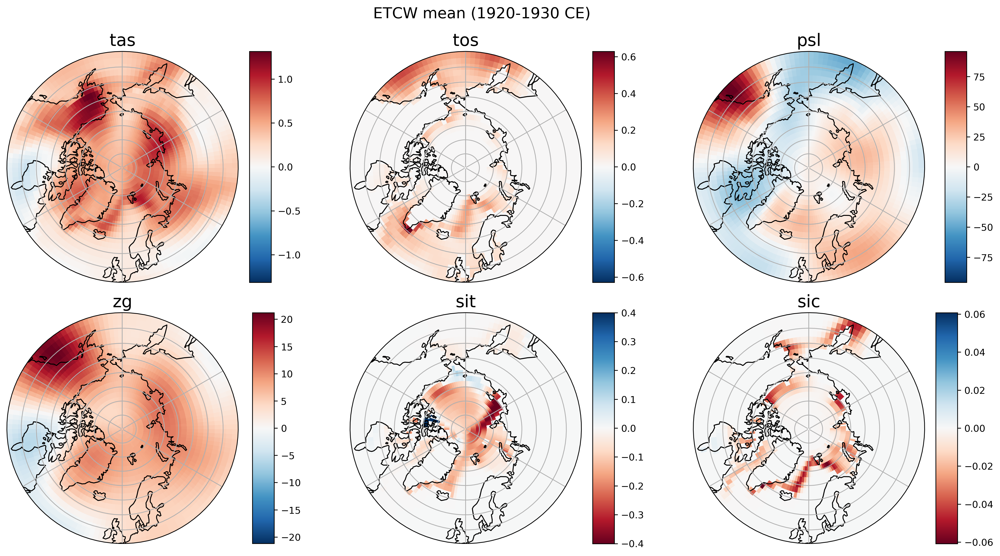

In [1418]:
#fig = plt.figure(2, figsize=(14, 18))
cmap_list = ['RdBu_r','RdBu_r','RdBu_r','RdBu_r','RdBu','RdBu']

fig,axs = plt.subplots(2,3, figsize=(15,8), constrained_layout=True,
                       subplot_kw={'projection':ccrs.NorthPolarStereo()})
ax = axs.flatten()
pltv = np.arange(4,8,1)

for v,var in enumerate(['tas','tos','psl','zg','sit','sic']):
    lat = LIMd['var_dict'][var]['lat']
    lon = LIMd['var_dict'][var]['lon']

    ens_mean = np.nanmean(Xa_dcomp_all[var],axis=0)
    ens_mean_3d = np.reshape(ens_mean,(lat.shape[0],lon.shape[0],ens_mean.shape[1]))
    
    mn = np.nanmean(ens_mean_3d[:,:,anom_period],axis=2)

    etcw = np.nanmean(ens_mean_3d[:,:,etcw_ind_10_1],axis=2) - mn
    
    if 'sit' in var: 
        limit = 0.4
    else: 
        limit = max(np.nanmax(etcw), np.abs(np.nanmin(etcw)))
    
    wrap_etcw, wrap_lon = add_cyclic_point(etcw, coord=lon)
    
    ax[v].coastlines()
    ax[v].gridlines()
    
    theta = np.linspace(0, 2*np.pi, 100)
    center, radius = [0.5, 0.5], 0.5
    verts = np.vstack([np.sin(theta), np.cos(theta)]).T
    circle = mpath.Path(verts * radius + center)

    ax[v].set_boundary(circle, transform=ax[v].transAxes)
    ax[v].set_extent([-180, 180, 90, 50], crs=ccrs.PlateCarree())
    cb1 = ax[v].pcolormesh(wrap_lon,lat,wrap_etcw,
                           cmap=cmap_list[v],transform=ccrs.PlateCarree(), 
                           vmin = -limit, vmax=limit)
    ax[v].set_title(var, fontsize=18)
    plt.colorbar(cb1, ax=ax[v])

plt.suptitle('ETCW mean (1920-1930 CE)', fontsize=16)

Text(0.5, 0.98, 'ETCW mean (1930-1940 CE)')

/home/disk/chaos/mkb22/anaconda2/envs/lims_update/lib/python3.6/site-packages/IPython/core/events.py:88: UserWarning: constrained_layout not applied.  At least one axes collapsed to zero width or height.
  func(*args, **kwargs)


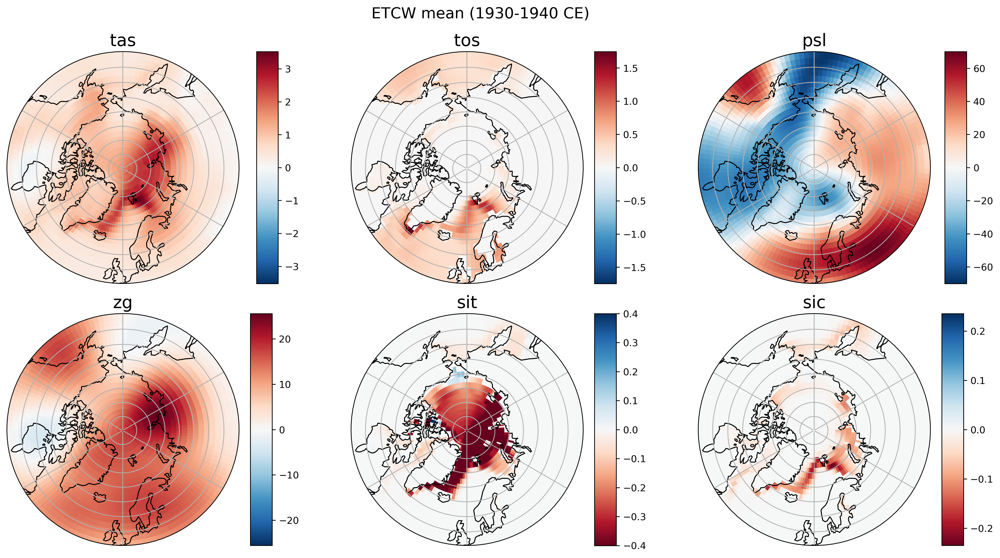

In [1417]:
#fig = plt.figure(2, figsize=(14, 18))
cmap_list = ['RdBu_r','RdBu_r','RdBu_r','RdBu_r','RdBu','RdBu']

fig,axs = plt.subplots(2,3, figsize=(15,8), constrained_layout=True,
                       subplot_kw={'projection':ccrs.NorthPolarStereo()})
ax = axs.flatten()
pltv = np.arange(4,8,1)

for v,var in enumerate(['tas','tos','psl','zg','sit','sic']):
    lat = LIMd['var_dict'][var]['lat']
    lon = LIMd['var_dict'][var]['lon']

    ens_mean = np.nanmean(Xa_dcomp_all[var],axis=0)
    ens_mean_3d = np.reshape(ens_mean,(lat.shape[0],lon.shape[0],ens_mean.shape[1]))
    
    mn = np.nanmean(ens_mean_3d[:,:,anom_period],axis=2)

    etcw = np.nanmean(ens_mean_3d[:,:,etcw_ind_10_2],axis=2) - mn
    
    if 'sit' in var: 
        limit = 0.4
    else: 
        limit = max(np.nanmax(etcw), np.abs(np.nanmin(etcw)))
    
    wrap_etcw, wrap_lon = add_cyclic_point(etcw, coord=lon)
    
    ax[v].coastlines()
    ax[v].gridlines()
    
    theta = np.linspace(0, 2*np.pi, 100)
    center, radius = [0.5, 0.5], 0.5
    verts = np.vstack([np.sin(theta), np.cos(theta)]).T
    circle = mpath.Path(verts * radius + center)

    ax[v].set_boundary(circle, transform=ax[v].transAxes)
    ax[v].set_extent([-180, 180, 90, 50], crs=ccrs.PlateCarree())
    cb1 = ax[v].pcolormesh(wrap_lon,lat,wrap_etcw,
                           cmap=cmap_list[v],transform=ccrs.PlateCarree(), 
                           vmin = -limit, vmax=limit)
    ax[v].set_title(var, fontsize=18)
    plt.colorbar(cb1, ax=ax[v])

plt.suptitle('ETCW mean (1930-1940 CE)', fontsize=16)

Text(0.5, 0.98, 'ETCW mean (1920-1940 CE)')

/home/disk/chaos/mkb22/anaconda2/envs/lims_update/lib/python3.6/site-packages/IPython/core/events.py:88: UserWarning: constrained_layout not applied.  At least one axes collapsed to zero width or height.
  func(*args, **kwargs)


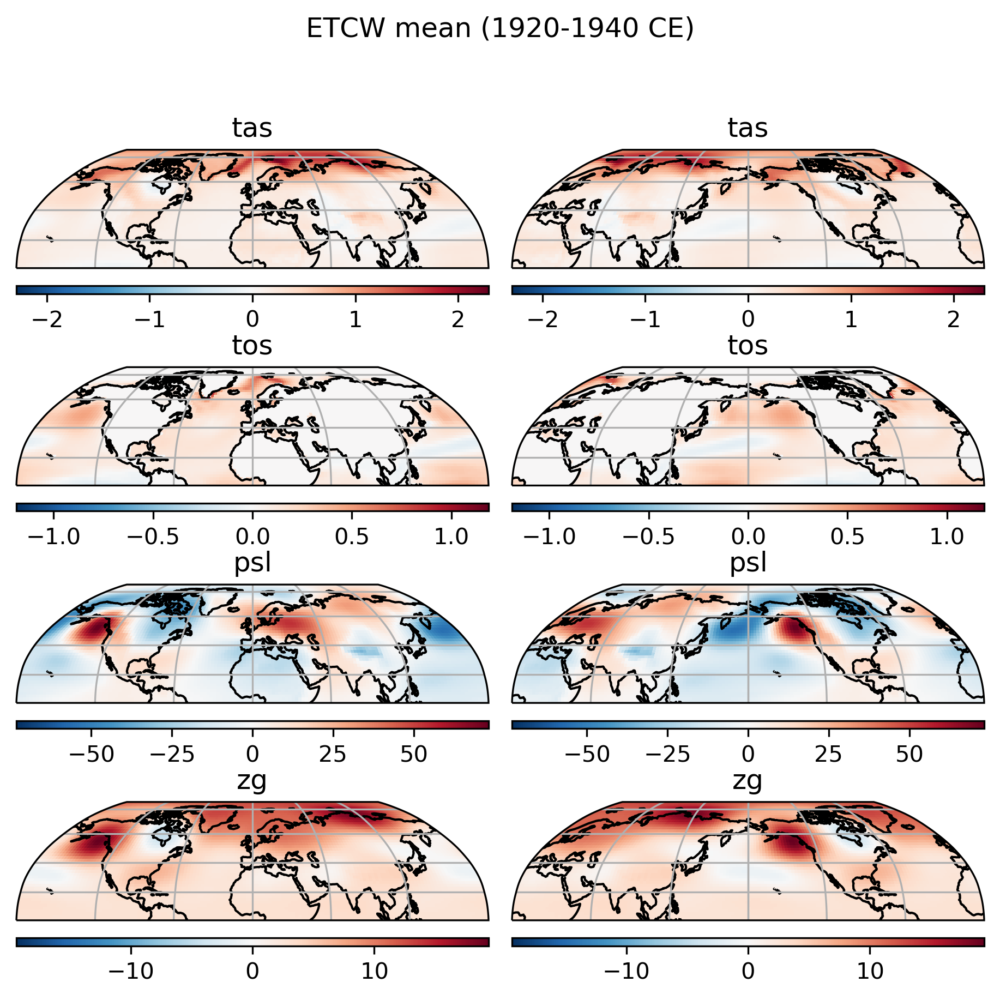

In [1413]:
#fig = plt.figure(2, figsize=(14, 18))
cmap_list = ['RdBu_r','RdBu_r','RdBu_r','RdBu_r','RdBu','RdBu']

# fig,axs = plt.subplots(4,2, figsize=(3,6), #constrained_layout=True,
#                        subplot_kw={'projection':ccrs.Robinson()})

fig = plt.figure(figsize=(6,6),constrained_layout=True)

for v,var in enumerate(['tas','tos','psl','zg']):
    lat = LIMd['var_dict'][var]['lat']
    lon = LIMd['var_dict'][var]['lon']

    ens_mean = np.nanmean(Xa_dcomp_all[var],axis=0)
    ens_mean_3d = np.reshape(ens_mean,(lat.shape[0],lon.shape[0],ens_mean.shape[1]))

    mn = np.nanmean(ens_mean_3d[:,:,anom_period],axis=2)
    etcw = np.nanmean(ens_mean_3d[:,:,etcw_ind_10_1],axis=2) - mn
    
    limit = max(np.nanmax(etcw), np.abs(np.nanmin(etcw)))
    
    wrap_etcw, wrap_lon = add_cyclic_point(etcw, coord=lon)
    
    ax1 = fig.add_subplot(4,2,2*v+1, projection=ccrs.Robinson(central_longitude=0))
    ax2 = fig.add_subplot(4,2,2*v+2, projection=ccrs.Robinson(central_longitude=180))

    cb1 = ax1.pcolormesh(wrap_lon,lat,wrap_etcw,
                           cmap=cmap_list[v],transform=ccrs.PlateCarree(), 
                           vmin = -limit, vmax=limit)
    cb2 = ax2.pcolormesh(wrap_lon,lat,wrap_etcw,
                           cmap=cmap_list[v],transform=ccrs.PlateCarree(), 
                           vmin = -limit, vmax=limit)
    ax1.set_title(var, fontsize=12)
    ax2.set_title(var, fontsize=12)
    plt.colorbar(cb1, ax=ax1, orientation='horizontal', aspect=60)
    plt.colorbar(cb2, ax=ax2, orientation='horizontal', aspect=60)
    
    ax1.coastlines()
    ax1.gridlines()
    ax2.coastlines()
    ax2.gridlines()

plt.suptitle('ETCW mean (1920-1940 CE)', fontsize=12)
#plt.tight_layout()

Text(0.5, 0.98, 'Before ETCW mean (1900--1919 CE)')

/home/disk/chaos/mkb22/anaconda2/envs/lims_update/lib/python3.6/site-packages/IPython/core/events.py:88: UserWarning: constrained_layout not applied.  At least one axes collapsed to zero width or height.
  func(*args, **kwargs)


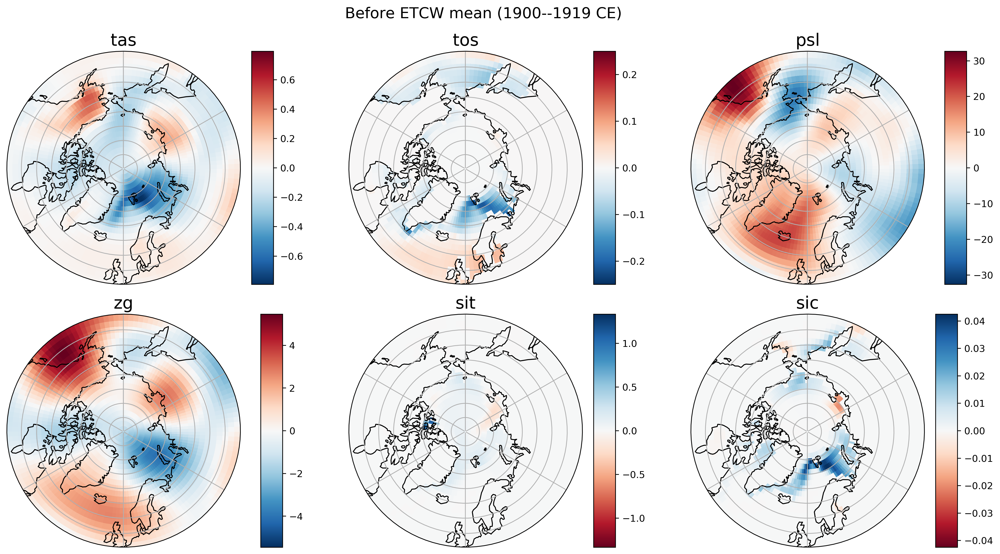

In [1414]:
#fig = plt.figure(2, figsize=(14, 18))
cmap_list = ['RdBu_r','RdBu_r','RdBu_r','RdBu_r','RdBu','RdBu']

fig,axs = plt.subplots(2,3, figsize=(15,8), constrained_layout=True,
                       subplot_kw={'projection':ccrs.NorthPolarStereo()})
ax = axs.flatten()
pltv = np.arange(4,8,1)

for v,var in enumerate(['tas','tos','psl','zg','sit','sic']):
    lat = LIMd['var_dict'][var]['lat']
    lon = LIMd['var_dict'][var]['lon']

    ens_mean = np.nanmean(Xa_dcomp_all[var],axis=0)
    ens_mean_3d = np.reshape(ens_mean,(lat.shape[0],lon.shape[0],ens_mean.shape[1]))
    
    mn = np.nanmean(ens_mean_3d[:,:,anom_period],axis=2)
    before_etcw = np.nanmean(ens_mean_3d[:,:,before_etcw_ind],axis=2) - mn
    
    limit = max(np.nanmax(before_etcw), np.abs(np.nanmin(before_etcw)))
    
    wrap_before_etcw, wrap_lon = add_cyclic_point(before_etcw, coord=lon)
    
    ax[v].coastlines()
    ax[v].gridlines()
    
    theta = np.linspace(0, 2*np.pi, 100)
    center, radius = [0.5, 0.5], 0.5
    verts = np.vstack([np.sin(theta), np.cos(theta)]).T
    circle = mpath.Path(verts * radius + center)

    ax[v].set_boundary(circle, transform=ax[v].transAxes)
    ax[v].set_extent([-180, 180, 90, 50], crs=ccrs.PlateCarree())
    cb1 = ax[v].pcolormesh(wrap_lon,lat,wrap_before_etcw,
                           cmap=cmap_list[v],transform=ccrs.PlateCarree(),
                           vmin=-limit, vmax=limit)
    ax[v].set_title(var, fontsize=18)
    plt.colorbar(cb1, ax=ax[v])
    
plt.suptitle('Before ETCW mean (1900--1919 CE)', fontsize=16)

## Calculate PDO: 

In [1185]:
sst_recon = Xa_dcomp_all['tos']
sst_recon.shape

(20, 6912, 2040)

In [1177]:
pdo_lat_min = 20
pdo_lat_max = 66
pdo_lon_min = 110
pdo_lon_max = 360-110

In [1178]:
lat = LIMd['var_dict']['tos']['lat']
lon = LIMd['var_dict']['tos']['lon']

In [1179]:
pdo_mask = np.zeros((lat.shape[0],lon.shape[0]))
pdo_lat_inds = ((lat>=pdo_lat_min)&(lat<=pdo_lat_max))
pdo_lon_inds = ((lon>=pdo_lon_min)&(lon<=pdo_lon_max))

In [1180]:
pdo_mask[pdo_lat_inds,:] = pdo_mask[pdo_lat_inds,:]+1
pdo_mask[:,pdo_lon_inds] = pdo_mask[:,pdo_lon_inds]+1
pdo_mask_final = np.where(pdo_mask>=2,1,0)
pdo_mask_final_1d = np.reshape(pdo_mask_final,(pdo_mask_final.shape[0]*pdo_mask_final.shape[1]))

In [1181]:
var = 'tos'
var_dict = LIMd['var_dict']

tot_var_forecast = np.zeros((niters,t_total))

print('Working on '+var)
units = areacell_dict_all[var][areawt_name[var]]['units']

if 'km' in units:
    acell = areacell[var]
elif 'centi' in units: 
    print('changing cellarea units from '+
          str(areacell_dict_all[var][areawt_name[var]]['units'])+' to km^2')
    acell = areacell[var]*(1e-10)
    units = 'km^2'
else: 
    print('changing cellarea units from '+
          str(areacell_dict_all[var][areawt_name[var]]['units'])+' to km^2')
    acell = areacell[var]*(1e-6)
    units = 'km^2'


Working on tos
changing cellarea units from m^2 to km^2


In [1186]:
sst_recon_pdo = np.zeros((it,sst_recon.shape[2]))

for i in range(it):
    var_nan_mask = np.where(np.isnan(sst_recon[i,:,:]),np.nan,1)
    sst_recon_areawt = np.nansum(acell[:,np.newaxis]*sst_recon[i,:,:]*pdo_mask_final_1d[:,np.newaxis],axis=0)
    wt_sum = np.nansum(acell[:,np.newaxis]*var_nan_mask*pdo_mask_final_1d[:,np.newaxis],axis=0)
    sst_recon_pdo[i,:] = sst_recon_areawt/wt_sum

In [1188]:
sst_recon_pdo_ensmn = np.nanmean(sst_recon_pdo,axis=0)

plt.plot(time,sst_recon_pdo_ensmn)
plt.axhline(0,linestyle='--',color='grey')

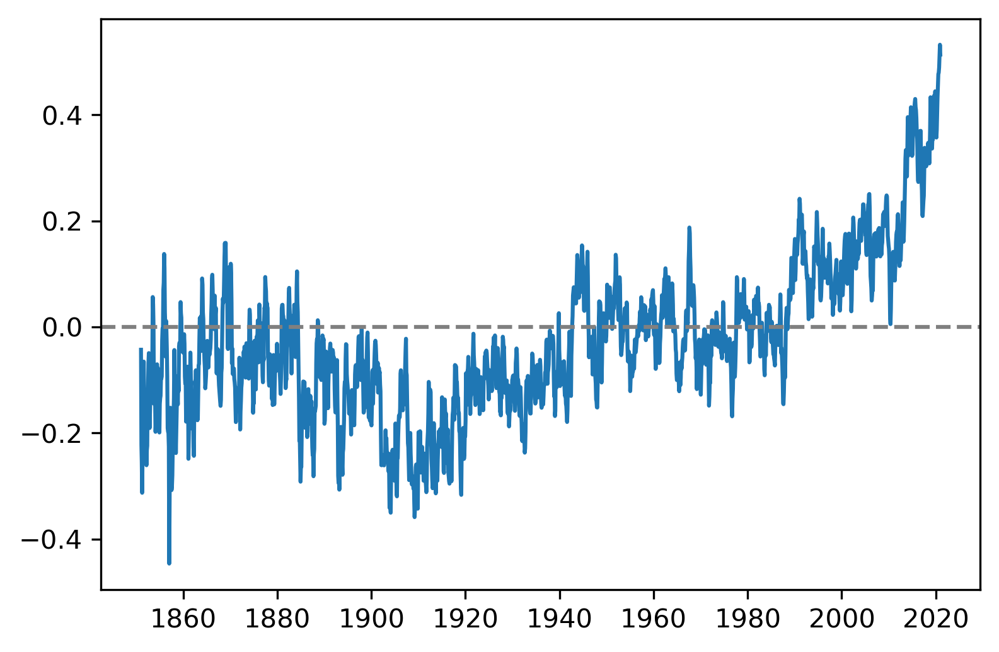

In [1190]:
plt.plot(time,sst_recon_pdo_ensmn)
plt.axhline(0,linestyle='--',color='grey')

## Calculate AMV: 

In [1222]:
amv_lat_min = 20
amv_lat_max = 66
amv_lon_min = 360-80
amv_lon_max = 360

In [1223]:
amv_mask = np.zeros((lat.shape[0],lon.shape[0]))
amv_lat_inds = ((lat>=amv_lat_min)&(lat<=amv_lat_max))
amv_lon_inds = ((lon>=amv_lon_min)&(lon<=amv_lon_max))

In [1224]:
amv_mask[amv_lat_inds,:] = amv_mask[amv_lat_inds,:]+1
amv_mask[:,amv_lon_inds] = amv_mask[:,amv_lon_inds]+1
amv_mask_final = np.where(amv_mask>=2,1,0)
amv_mask_final_1d = np.reshape(amv_mask_final,(amv_mask_final.shape[0]*amv_mask_final.shape[1]))

In [1225]:
sst_recon_amv = np.zeros((it,sst_recon.shape[2]))

for i in range(it):
    var_nan_mask = np.where(np.isnan(sst_recon[i,:,:]),np.nan,1)
    sst_recon_areawt = np.nansum(acell[:,np.newaxis]*sst_recon[i,:,:]*amv_mask_final_1d[:,np.newaxis],axis=0)
    wt_sum = np.nansum(acell[:,np.newaxis]*var_nan_mask*amv_mask_final_1d[:,np.newaxis],axis=0)
    sst_recon_amv[i,:] = sst_recon_areawt/wt_sum

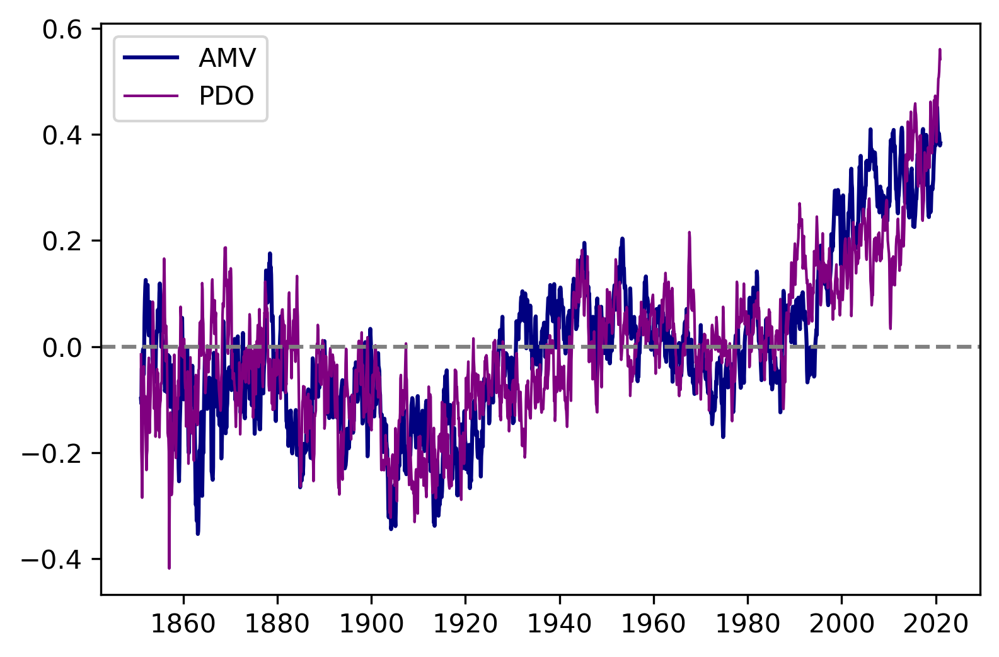

In [1230]:
sst_recon_amv_ensmn = np.nanmean(sst_recon_amv,axis=0)

plt.plot(time,sst_recon_amv_ensmn - np.nanmean(sst_recon_amv_ensmn), color='navy', label='AMV', linewidth=1.5)
plt.plot(time,sst_recon_pdo_ensmn- np.nanmean(sst_recon_pdo_ensmn), color='purple', label='PDO', linewidth=1)
plt.axhline(0,linestyle='--',color='grey')
plt.legend()

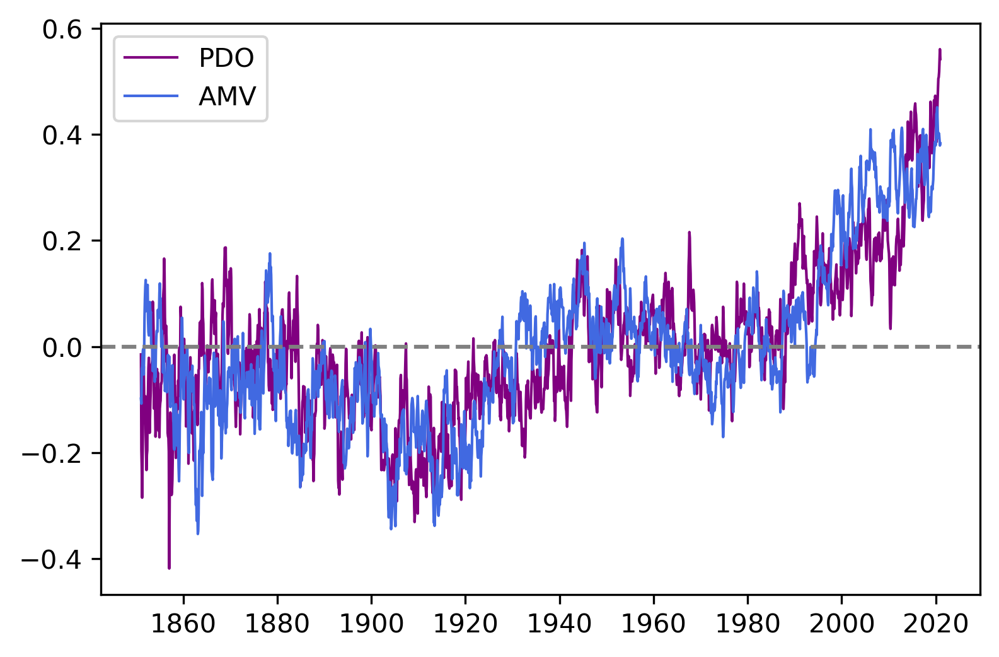

In [1233]:
sst_recon_amv_ensmn = np.nanmean(sst_recon_amv,axis=0)

plt.plot(time,sst_recon_pdo_ensmn- np.nanmean(sst_recon_pdo_ensmn), color='purple', label='PDO', linewidth=1)
plt.plot(time,sst_recon_amv_ensmn - np.nanmean(sst_recon_amv_ensmn), color='royalblue', label='AMV', linewidth=1)

plt.axhline(0,linestyle='--',color='grey')
plt.legend()

/home/disk/chaos/mkb22/anaconda2/envs/lims_update/lib/python3.6/site-packages/IPython/core/events.py:88: UserWarning: constrained_layout not applied.  At least one axes collapsed to zero width or height.
  func(*args, **kwargs)


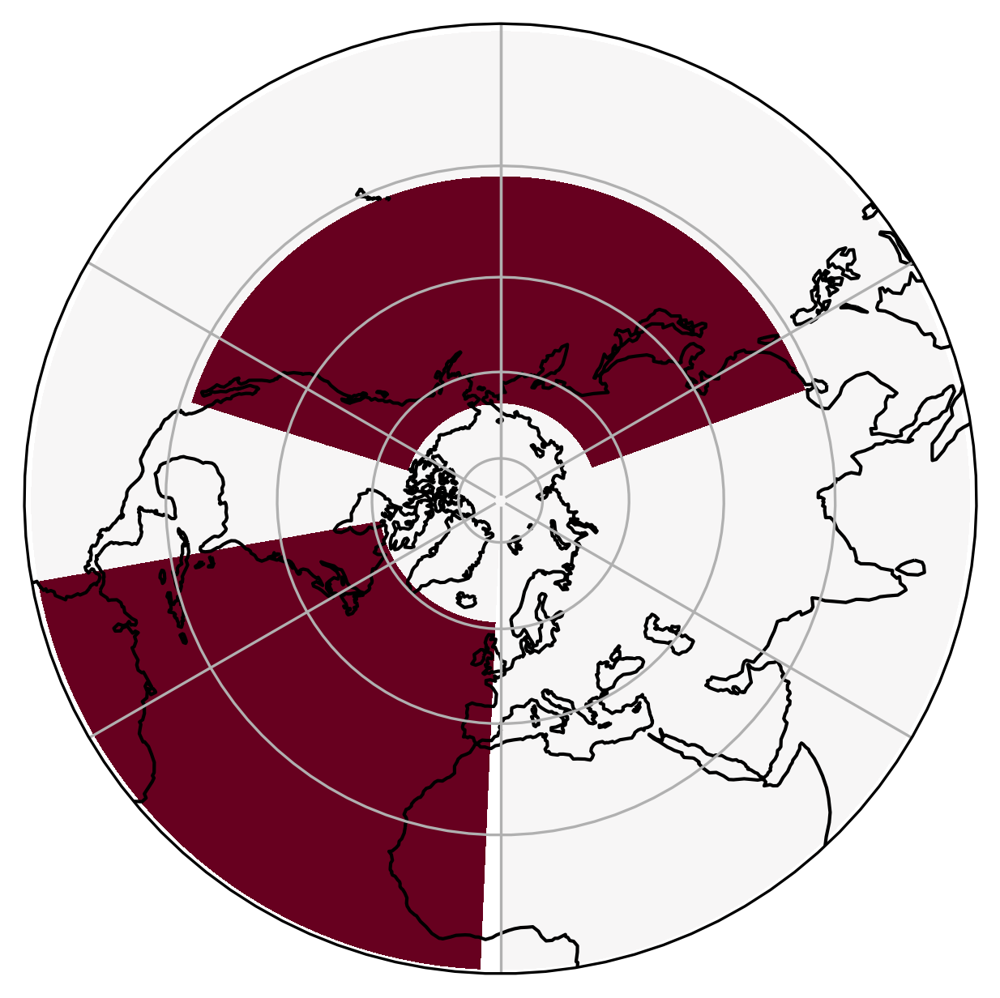

In [1215]:
#fig = plt.figure(2, figsize=(14, 18))
cmap_list = ['RdBu_r','RdBu_r','RdBu_r','RdBu_r','RdBu','RdBu']

fig,ax = plt.subplots(1,1, figsize=(4,5), constrained_layout=True,
                       subplot_kw={'projection':ccrs.NorthPolarStereo()})
    
ax.coastlines()
ax.gridlines()

theta = np.linspace(0, 2*np.pi, 100)
center, radius = [0.5, 0.5], 0.5
verts = np.vstack([np.sin(theta), np.cos(theta)]).T
circle = mpath.Path(verts * radius + center)

ax.set_boundary(circle, transform=ax.transAxes)
ax.set_extent([-180, 180, 90, 0], crs=ccrs.PlateCarree())
cb1 = ax.pcolormesh(lon,lat,amv_mask_final+pdo_mask_final,
                       cmap=cmap_list[0],transform=ccrs.PlateCarree(),
                       vmin=-1, vmax=1)
#plt.colorbar(cb1, ax=ax)

## Presentation Intro Slide Figures: 

(9, 13)

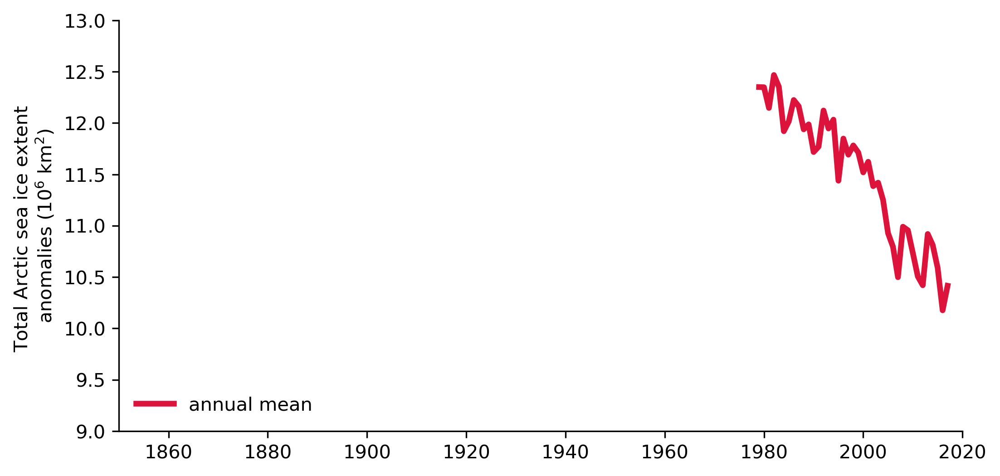

In [24]:
fig,ax = plt.subplots(1,1, figsize=(8,4))

plt.plot(fet_time,np.nanmean(sat_sie_mo,axis=1), color='crimson', label='annual mean', linewidth=3)

plt.legend(loc='lower left', frameon=False)
plt.ylabel('Total Arctic sea ice extent \nanomalies (10$^6$ km$^2$)')

ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)

# plt.text(1855,-1.6,('R$^2$ = '+str(np.round(corr_sat_recon_annual**2,2))+
#          ', CE = '+str(np.round(ce_sat_recon_annual,2))))

plt.xlim(1850,2020)
plt.ylim(9,13)

In [672]:
cmap = plt.cm.get_cmap('Reds')
blah = np.arange(0.2,1,0.8/12)
red_colors = [cmap(i) for i in blah]

(0, 15)

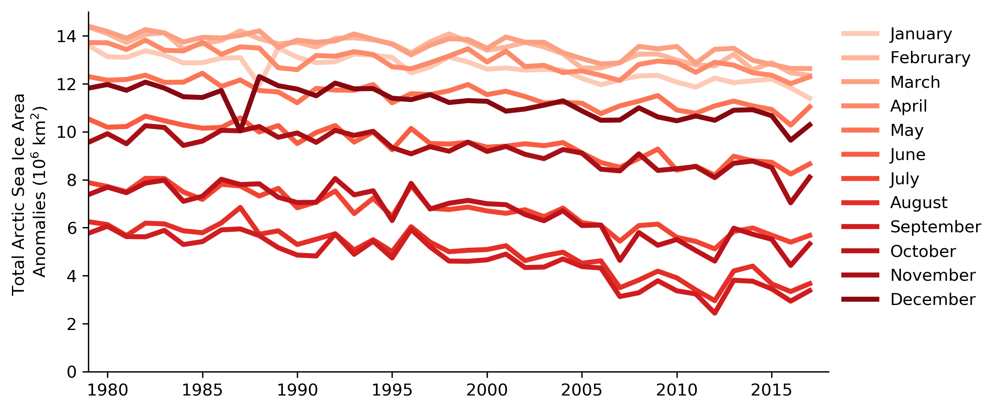

In [676]:
fig,ax = plt.subplots(1,1, figsize=(8,4))

for i in range(12):
    plt.plot(fet_time,sat_sia_mo[:,i], color=red_colors[i], label=month_names[i], linewidth=3)

plt.legend(bbox_to_anchor=[1,1], frameon=False)
plt.ylabel('Total Arctic Sea Ice Area \nAnomalies (10$^6$ km$^2$)')

ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)

# plt.text(1855,-1.6,('R$^2$ = '+str(np.round(corr_sat_recon_annual**2,2))+
#          ', CE = '+str(np.round(ce_sat_recon_annual,2))))

plt.xlim(1979,2018)
plt.ylim(0,15)

In [686]:
cmap = plt.cm.get_cmap('Reds')
blah = np.arange(0.2,1,0.8/39)
red_colors = [cmap(i) for i in blah]

In [711]:
fet_time

array([1979, 1980, 1981, 1982, 1983, 1984, 1985, 1986, 1987, 1988, 1989,
       1990, 1991, 1992, 1993, 1994, 1995, 1996, 1997, 1998, 1999, 2000,
       2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011,
       2012, 2013, 2014, 2015, 2016, 2017])

(2, 15)

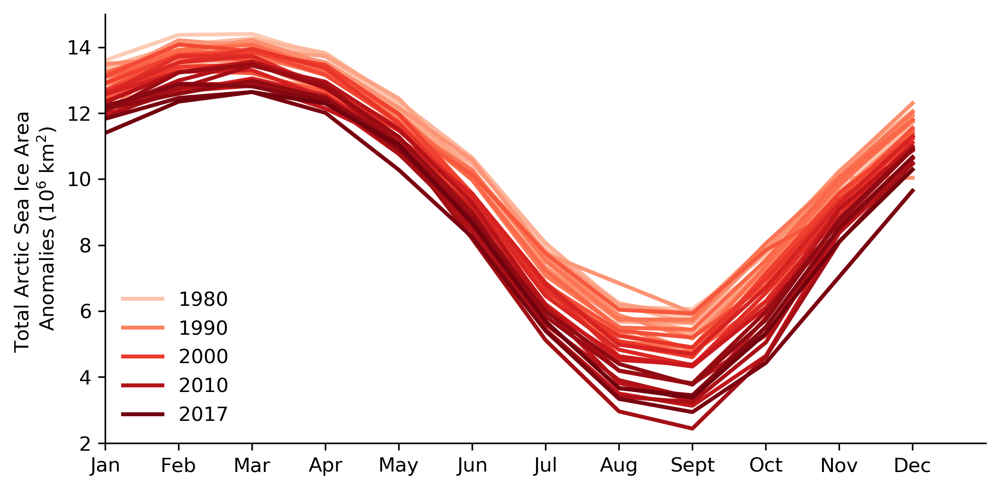

In [720]:
fig,ax = plt.subplots(1,1, figsize=(8,4))

for i in range(39):
    if fet_time[i]>2016: 
        plt.plot(sat_sia_mo[i,:], color=red_colors[i], linewidth=2,label = str(fet_time[i]))
    elif fet_time[i]%10>0:
        plt.plot(sat_sia_mo[i,:], color=red_colors[i], linewidth=2)
    else: 
        plt.plot(sat_sia_mo[i,:], color=red_colors[i], linewidth=2,label = str(fet_time[i]))

plt.legend(loc='lower left', frameon=False)
plt.ylabel('Total Arctic Sea Ice Area \nAnomalies (10$^6$ km$^2$)')

ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)

# plt.text(1855,-1.6,('R$^2$ = '+str(np.round(corr_sat_recon_annual**2,2))+
#          ', CE = '+str(np.round(ce_sat_recon_annual,2))))

plt.xlim(0,12)
plt.xticks(np.arange(0,12,1),months)
plt.ylim(2,15)

(2, 15)

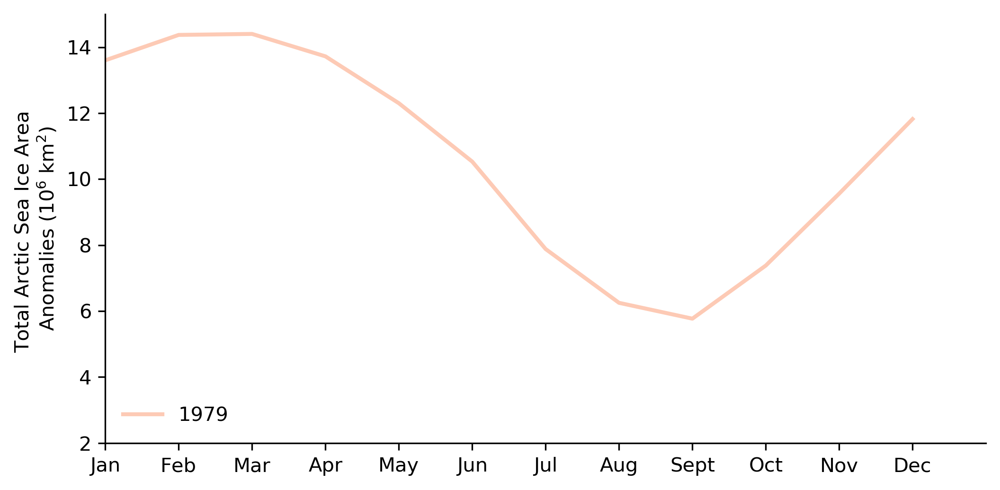

In [719]:
fig,ax = plt.subplots(1,1, figsize=(8,4))
i=0
plt.plot(sat_sia_mo[i,:], color=red_colors[i], linewidth=2,label = str(fet_time[i]))

plt.legend(loc='lower left', frameon=False)
plt.ylabel('Total Arctic Sea Ice Area \nAnomalies (10$^6$ km$^2$)')

ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)

# plt.text(1855,-1.6,('R$^2$ = '+str(np.round(corr_sat_recon_annual**2,2))+
#          ', CE = '+str(np.round(ce_sat_recon_annual,2))))

plt.xlim(0,12)
plt.xticks(np.arange(0,12,1),months)
plt.ylim(2,15)

## Full field: Spatial skill: 

In [455]:
corr_all = {}
ce_all = {}

for var in limvars: 
    corr_var = np.zeros((Xa_dcomp_all[var].shape[0]))
    ce_var = np.zeros((Xa_dcomp_all[var].shape[0]))

    for i in range(Xa_dcomp_all[var].shape[0]):
        corr_var[i] = np.corrcoef(X_var_all[var][i,:],Xa_dcomp_all[var][i,:])[0,1]
        ce_var[i] = oda.coefficient_efficiency(X_var_all[var][i,:],Xa_dcomp_all[var][i,:])

    corr_var_2d = np.reshape(corr_var,(LIMd['var_dict'][var]['lat'].shape[0],LIMd['var_dict'][var]['lon'].shape[0]))
    ce_var_2d = np.reshape(ce_var,(LIMd['var_dict'][var]['lat'].shape[0],LIMd['var_dict'][var]['lon'].shape[0]))
    
    corr_all[var] = corr_var_2d
    ce_all[var] = ce_var_2d

NameError: name 'X_var_all' is not defined

In [456]:
from cartopy.util import add_cyclic_point

KeyError: 'tas'

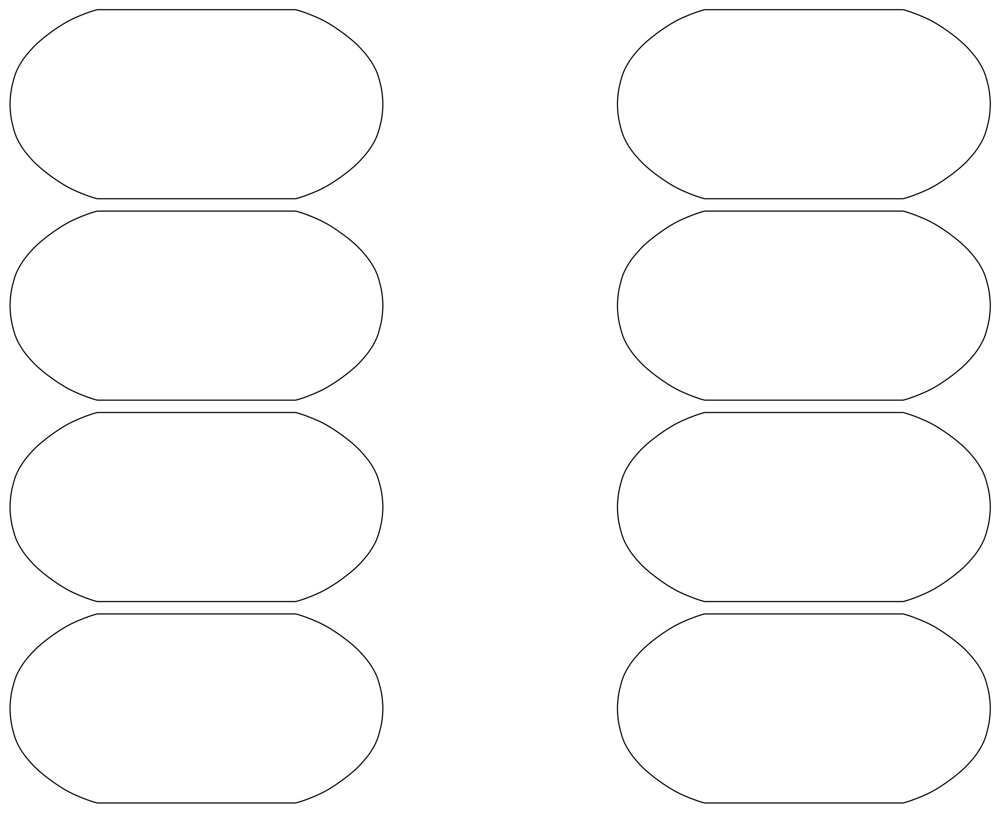

In [457]:
#fig = plt.figure(2, figsize=(14, 18))
fig,axs = plt.subplots(4,2, figsize=(12, 8), constrained_layout=True,
                       subplot_kw={'projection':ccrs.Robinson()})
ax = axs.flatten()
pltv = np.arange(0,8,2)

for v,var in enumerate(['tas','psl','zg','tos']): 
    lat = LIMd['var_dict'][var]['lat']
    lon = LIMd['var_dict'][var]['lon']
    
    wrap_corr, wrap_lon = add_cyclic_point(corr_all[var], coord=lon)
    wrap_ce, wrap_lon = add_cyclic_point(ce_all[var], coord=lon)
    
    i = pltv[v]
    ax[i].coastlines()
    cb1 = ax[i].pcolormesh(wrap_lon,lat,wrap_corr,
                           cmap='Reds',transform=ccrs.PlateCarree(),
                           vmin=0, vmax=1)

    ax[i+1].coastlines()
    cb2 = ax[i+1].pcolormesh(wrap_lon,lat,wrap_ce,
                             cmap='RdBu_r',transform=ccrs.PlateCarree(),
                             vmin=-1, vmax=1)

ax[0].set_title('Correlation', fontsize=18)
ax[1].set_title('CE', fontsize=18)

plt.colorbar(cb1, orientation='horizontal', shrink=0.8, ax=ax[6])
plt.colorbar(cb2, orientation='horizontal', shrink=0.8, ax=ax[7])

plt.tight_layout()

KeyError: 'tas'

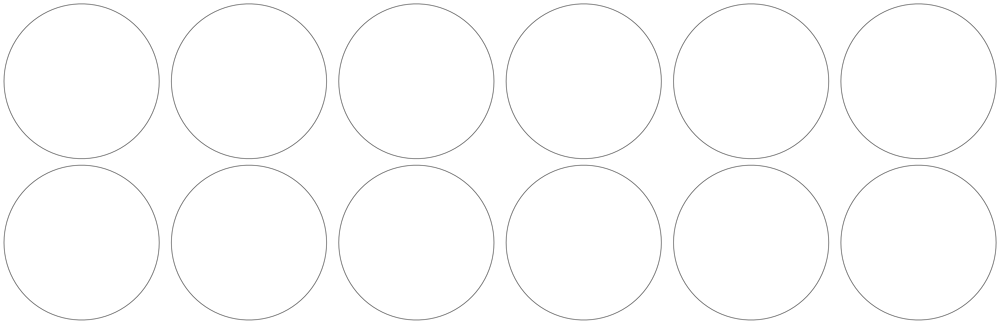

In [458]:
#fig = plt.figure(2, figsize=(14, 18))
fig,axs = plt.subplots(2,6, figsize=(25,8),constrained_layout=True,
                       subplot_kw={'projection':ccrs.NorthPolarStereo()})
ax = axs.flatten()
pltv = np.arange(6,12,1)

for v,var in enumerate(limvars):
    lat = LIMd['var_dict'][var]['lat']
    lon = LIMd['var_dict'][var]['lon']
    
    wrap_corr, wrap_lon = add_cyclic_point(corr_all[var], coord=lon)
    wrap_ce, wrap_lon = add_cyclic_point(ce_all[var], coord=lon)
    
    ax[v].coastlines()
    ax[v].gridlines()
    
    theta = np.linspace(0, 2*np.pi, 100)
    center, radius = [0.5, 0.5], 0.5
    verts = np.vstack([np.sin(theta), np.cos(theta)]).T
    circle = mpath.Path(verts * radius + center)

    ax[v].set_boundary(circle, transform=ax[v].transAxes)
    ax[v].set_extent([-180, 180, 90, 50], crs=ccrs.PlateCarree())
    cb1 = ax[v].pcolormesh(wrap_lon,lat,wrap_corr,
                           cmap='Reds',transform=ccrs.PlateCarree(),
                           vmin=0, vmax=1)
    i = pltv[v]
    ax[i].coastlines()
    ax[i].gridlines()
    
    theta = np.linspace(0, 2*np.pi, 100)
    center, radius = [0.5, 0.5], 0.5
    verts = np.vstack([np.sin(theta), np.cos(theta)]).T
    circle = mpath.Path(verts * radius + center)

    ax[i].set_boundary(circle, transform=ax[i].transAxes)
    ax[i].set_extent([-180, 180, 90, 50], crs=ccrs.PlateCarree())
    cb2 = ax[i].pcolormesh(wrap_lon,lat,wrap_ce,
                           cmap='RdBu_r',transform=ccrs.PlateCarree(),
                           vmin=-1, vmax=1)
    
    ax[v].set_title(var, fontsize=18)


colb1 = fig.colorbar(cb1, location='left',shrink=0.8, ax=ax[0],aspect=30)
colb2 = plt.colorbar(cb2, location='left',shrink=0.8, ax=ax[6],aspect=30)

colb1.set_label(label='Correlation', size=20)
colb2.set_label(label='Coeffient of Efficiency', size=20)

plt.tight_layout()

/home/disk/chaos/mkb22/anaconda2/envs/lims_update/lib/python3.6/site-packages/IPython/core/events.py:88: UserWarning: constrained_layout not applied.  At least one axes collapsed to zero width or height.
  func(*args, **kwargs)


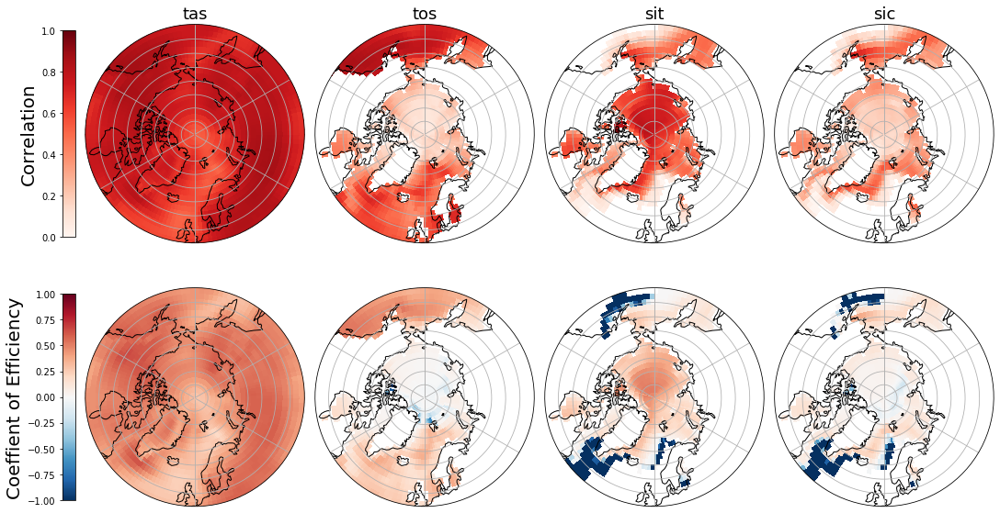

In [95]:
#fig = plt.figure(2, figsize=(14, 18))
fig,axs = plt.subplots(2,4, figsize=(15,8), constrained_layout=True,
                       subplot_kw={'projection':ccrs.NorthPolarStereo()})
ax = axs.flatten()
pltv = np.arange(4,8,1)

for v,var in enumerate(['tas','tos','sit','sic']):
    lat = LIMd['var_dict'][var]['lat']
    lon = LIMd['var_dict'][var]['lon']
    
    wrap_corr, wrap_lon = add_cyclic_point(corr_all[var], coord=lon)
    wrap_ce, wrap_lon = add_cyclic_point(ce_all[var], coord=lon)
    
    ax[v].coastlines()
    ax[v].gridlines()
    
    theta = np.linspace(0, 2*np.pi, 100)
    center, radius = [0.5, 0.5], 0.5
    verts = np.vstack([np.sin(theta), np.cos(theta)]).T
    circle = mpath.Path(verts * radius + center)

    ax[v].set_boundary(circle, transform=ax[v].transAxes)
    ax[v].set_extent([-180, 180, 90, 50], crs=ccrs.PlateCarree())
    cb1 = ax[v].pcolormesh(wrap_lon,lat,wrap_corr,
                           cmap='Reds',transform=ccrs.PlateCarree(),
                           vmin=0, vmax=1)
    i = pltv[v]
    ax[i].coastlines()
    ax[i].gridlines()
    
    theta = np.linspace(0, 2*np.pi, 100)
    center, radius = [0.5, 0.5], 0.5
    verts = np.vstack([np.sin(theta), np.cos(theta)]).T
    circle = mpath.Path(verts * radius + center)

    ax[i].set_boundary(circle, transform=ax[i].transAxes)
    ax[i].set_extent([-180, 180, 90, 50], crs=ccrs.PlateCarree())
    cb2 = ax[i].pcolormesh(wrap_lon,lat,wrap_ce,
                           cmap='RdBu_r',transform=ccrs.PlateCarree(),
                           vmin=-1, vmax=1)
    
    ax[v].set_title(var, fontsize=18)


ax[0].set_ylabel('Correlation', fontsize=18)
# ax[1].set_title('CE', fontsize=18)

colb1 = fig.colorbar(cb1, location='left',shrink=0.8, ax=ax[0],aspect=30)
colb2 = plt.colorbar(cb2, location='left',shrink=0.8, ax=ax[4],aspect=30)

colb1.set_label(label='Correlation', size=20)
colb2.set_label(label='Coeffient of Efficiency', size=20)
#plt.tight_layout()

In [96]:
time

array([datetime.datetime(1850, 1, 15, 0, 0),
       datetime.datetime(1850, 2, 15, 0, 0),
       datetime.datetime(1850, 3, 15, 0, 0), ...,
       datetime.datetime(2004, 10, 15, 0, 0),
       datetime.datetime(2004, 11, 15, 0, 0),
       datetime.datetime(2004, 12, 15, 0, 0)], dtype=object)